Все ДЗ состоит из двух частей. Первая часть более развернутая и экспериментальная - в ней вам нужно будет обучить архитектуру для задачи Image Classification. Вам нужно реализовать архитектуру, обучить ее, а так же выполнить некоторые дополнительные задания. Вторая часть более простая - вам просто требуется разобраться во фреймворке и запустить его на данных.

In [ ]:
import os
os.environ['KAGGLE_USERNAME'] = ""
os.environ['KAGGLE_KEY'] = ""

In [ ]:
!kaggle datasets download -d slothkong/10-monkey-species

100% 545M/547M [00:24<00:00, 22.2MB/s]
100% 547M/547M [00:24<00:00, 23.5MB/s]


In [ ]:
import zipfile
with zipfile.ZipFile('10-monkey-species.zip', 'r') as zip_ref:
    zip_ref.extractall()

# ДЗ 2.1 Image classification. 16 баллов.

В качестве датасета будет использовать вот этот - https://www.kaggle.com/datasets/slothkong/10-monkey-species

In [ ]:
# import os
# print(os.listdir("./archive"))

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import tensorflow as tf
import random
from IPython.display import clear_output
from matplotlib.pyplot import figure

from tensorflow import keras
from tensorflow.keras.preprocessing import image
from tensorflow.keras import layers
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.python.ops.gen_batch_ops import Batch
from tensorflow.keras.layers import Dense, Flatten, Dropout, MaxPooling2D, Conv2D, AvgPool2D, GlobalAveragePooling2D, BatchNormalization
from tensorflow.keras.models import Model
from tensorflow.keras.losses import CategoricalCrossentropy
from tensorflow.keras.optimizers import Adam,SGD
from tensorflow.keras import callbacks
from tensorflow.keras.utils import plot_model
from keras import metrics

import torch
import torchvision
from torch import nn
import torchsummary

from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt

# Dataset

Посмотрим на информацию о данных

In [ ]:
labels_info = pd.read_csv('./archive/monkey_labels.txt')
labels = labels_info[' Common Name                   ']
training_data = './archive/training/training'
validation_data = './archive/validation/validation'
labels_info

,Label,Latin Name,Common Name,Train Images,Validation Images
0,n0,alouatta_palliata\t,mantled_howler,131,26
1,n1,erythrocebus_patas\t,patas_monkey,139,28
2,n2,cacajao_calvus\t,bald_uakari,137,27
3,n3,macaca_fuscata\t,japanese_macaque,152,30
4,n4,cebuella_pygmea\t,pygmy_marmoset,131,26
5,n5,cebus_capucinus\t,white_headed_capuchin,141,28
6,n6,mico_argentatus\t,silvery_marmoset,132,26
7,n7,saimiri_sciureus\t,common_squirrel_monkey,142,28
8,n8,aotus_nigriceps\t,black_headed_night_monkey,133,27
9,n9,trachypithecus_johnii,nilgiri_langur,132,26


In [ ]:
labels

0     mantled_howler                
1     patas_monkey                  
2     bald_uakari                   
3     japanese_macaque              
4     pygmy_marmoset                
5     white_headed_capuchin         
6     silvery_marmoset              
7     common_squirrel_monkey        
8     black_headed_night_monkey     
9     nilgiri_langur                
Name:  Common Name                   , dtype: object

In [ ]:
NUM_CLASSES = len(labels)
NUM_CLASSES

10

Выведем несколько изображений

In [ ]:
from pathlib import Path
from matplotlib import pyplot as plt
import random
import cv2
import os

def image_show(num_image,label):
    for i in range(num_image):
        imgdir = Path(training_data + '/' + label)
        imgfile = random.choice(os.listdir(imgdir))
        img = cv2.imread(training_data + '/' + label + '/' + imgfile)
        plt.figure(i)
        plt.imshow(img)
        plt.title(imgfile)
    plt.show()

 pygmy_marmoset                


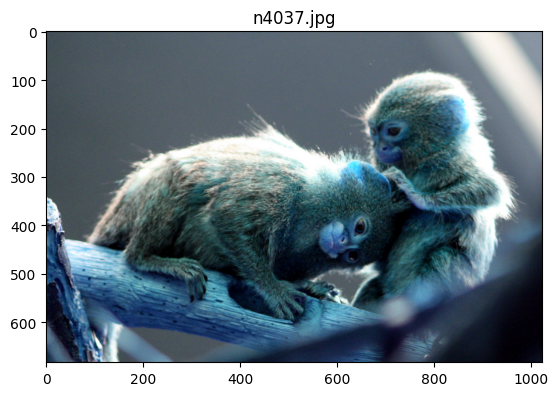

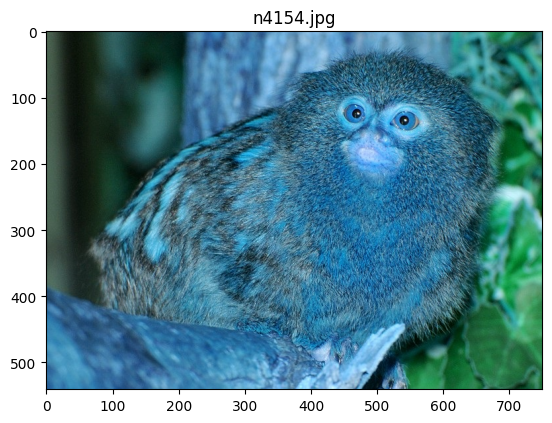

In [ ]:
print(labels[4])
image_show(2,'n4')

# Dataloader

Добавим аугментацию:
1) RandomRotation - увеличит количество данных, но больше чем на 45 градусов поворачивать не надо, тогда обезьяны будут перевернуты не как в реальной жизни
2) RandomHorizontalFlip - по горизонтали тоже можем повернуть на 180 градусов, а по вертикали уже никак, потому что важно сохранить правильное положение верха и низа
3) Normalize - для нормализации изображения

Также можно было бы сделать изменения в цвете, но для классификации обезьян важно сохранить цвет, потому что это одна из отличительных черт обезьян разных типов

In [ ]:

train_data_transform = torchvision.transforms.Compose([
    torchvision.transforms.Resize(size=(256, 256)),
    torchvision.transforms.CenterCrop(224),
    torchvision.transforms.RandomRotation(degrees=(-45, 45)),
    torchvision.transforms.RandomHorizontalFlip(),
    torchvision.transforms.ToTensor(),
    torchvision.transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
])

validation_data_transform = torchvision.transforms.Compose([
    torchvision.transforms.Resize(size=(256, 256)),
    torchvision.transforms.CenterCrop(224),
    torchvision.transforms.ToTensor(),
    torchvision.transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
])

In [ ]:
train_data = torchvision.datasets.ImageFolder(
    root=training_data,
    transform=train_data_transform
)

valid_data = torchvision.datasets.ImageFolder(
    root=validation_data,
    transform=validation_data_transform
)

In [ ]:
BATCH_SIZE = 16
NUM_WORKERS = os.cpu_count()

train_dataloader = torch.utils.data.DataLoader(
    dataset=train_data,
    batch_size=BATCH_SIZE,
    num_workers=NUM_WORKERS,
    shuffle=True
)

test_dataloader = torch.utils.data.DataLoader(
    dataset=valid_data,
    batch_size=BATCH_SIZE,
    num_workers=NUM_WORKERS,
    shuffle=False
)

Посмотрим какие получились изображения

In [ ]:
def imshow(image, ax=None, title=None, normalize=False):
    """Imshow for Tensor."""
    if ax is None:
        fig, ax = plt.subplots()
    image = image.numpy().transpose((1, 2, 0))

    if normalize:
        mean = np.array([0.485, 0.456, 0.406])
        std = np.array([0.229, 0.224, 0.225])
        image = std * image + mean
        image = np.clip(image, 0, 1)

    ax.imshow(image)
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.spines['left'].set_visible(False)
    ax.spines['bottom'].set_visible(False)
    ax.tick_params(axis='both', length=0)
    ax.set_xticklabels('')
    ax.set_yticklabels('')

    return ax

/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


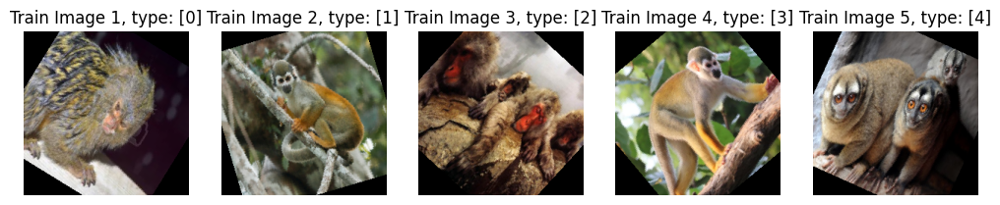

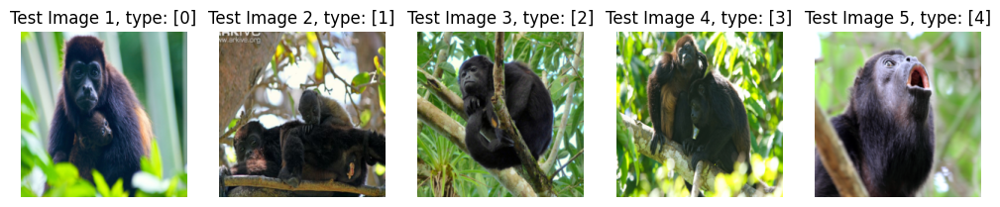

In [ ]:
for loader_str, loader in [('Train Image', train_dataloader),
                           ('Test Image', test_dataloader)]:
    data_iter = iter(loader)

    images, labels = next(data_iter)

    ncol = 5
    fig, axes = plt.subplots(figsize=(12.5,4),
                             ncols=ncol)
    for ii in range(ncol):
        ax = axes[ii]
        imshow(images[ii],
               ax=ax,
               normalize=True)
        ax.set_title('{} {}, type: {}'.format(loader_str, ii+1, [ii]))

## ResNet50.

Реализуйте ResNet50. Чтобы вспомнить архитектуру, обратитесь к лекции + оригинальной статье авторов+google.

Если хотите реализовать что-то поинтереснее (ViT) - делайте, будет учтено.

Что будет оцениваться в задании:
* ResNet50 from scratch **6 баллов**
* добавьте аугментаций, напишите краткое саммари почему выбрали именно такой набор аугментаций. **1 балл**
* дописать логику обучения модели **2 балла**
* дописать логику тестирования модели **1 балл**
* возьмите еще 2 модели из зоопарка моделей [torchvision](https://pytorch.org/vision/stable/models.html?), зафайнтюньте на наш датасет. Сравните их между собой и вашей реализацией. **4 балла**
* обязательно в конце напишите общий отчет о проделанной работе. Для лучшей модели проведите анализ метрик и ошибок, постройте confusion_matrix и classification report **2 балла**
* графики обучения обязательно должны присутсвовать

**NOTE**: рядом лежит ноутбук с baseline solution, вы можете отталкиваться от него, если хотите.

In [ ]:
import torch
import torch.nn as  nn


class Bottleneck(nn.Module):
    expansion = 4
    def __init__(self, in_channels, out_channels, i_downsample=None, stride=1):
        super(Bottleneck, self).__init__()

        self.conv1 = nn.Conv2d(in_channels, out_channels, kernel_size=1, stride=1, padding=0)
        self.batch_norm1 = nn.BatchNorm2d(out_channels)

        self.conv2 = nn.Conv2d(out_channels, out_channels, kernel_size=3, stride=stride, padding=1)
        self.batch_norm2 = nn.BatchNorm2d(out_channels)

        self.conv3 = nn.Conv2d(out_channels, out_channels*self.expansion, kernel_size=1, stride=1, padding=0)
        self.batch_norm3 = nn.BatchNorm2d(out_channels*self.expansion)

        self.i_downsample = i_downsample
        self.stride = stride
        self.relu = nn.ReLU()

    def forward(self, x):
        identity = x.clone()
        x = self.relu(self.batch_norm1(self.conv1(x)))

        x = self.relu(self.batch_norm2(self.conv2(x)))

        x = self.conv3(x)
        x = self.batch_norm3(x)

        #downsample if needed
        if self.i_downsample is not None:
            identity = self.i_downsample(identity)
        #add identity
        x += identity
        x = self.relu(x)

        return x

class ResNet50(nn.Module):
    def __init__(self, num_classes, layer_list=[3,4,6,3], num_channels=3):
        super(ResNet50, self).__init__()
        self.in_channels = 224

        self.conv1 = nn.Conv2d(num_channels, 224, kernel_size=7, stride=2, padding=3, bias=False)
        self.batch_norm1 = nn.BatchNorm2d(224)
        self.relu = nn.ReLU()
        self.max_pool = nn.MaxPool2d(kernel_size = 3, stride=2, padding=1)

        self.layer1 = self._make_layer(Bottleneck, layer_list[0], planes=64)
        self.layer2 = self._make_layer(Bottleneck, layer_list[1], planes=128, stride=2)
        self.layer3 = self._make_layer(Bottleneck, layer_list[2], planes=256, stride=2)
        self.layer4 = self._make_layer(Bottleneck, layer_list[3], planes=512, stride=2)

        self.avgpool = nn.AdaptiveAvgPool2d((1,1))
        self.fc = nn.Linear(512 * Bottleneck.expansion, num_classes)

    def forward(self, x):
        x = self.relu(self.batch_norm1(self.conv1(x)))
        x = self.max_pool(x)

        x = self.layer1(x)
        x = self.layer2(x)
        x = self.layer3(x)
        x = self.layer4(x)

        x = self.avgpool(x)
        x = x.reshape(x.shape[0], -1)
        x = self.fc(x)

        return x

    def _make_layer(self, ResBlock, blocks, planes, stride=1):
        ii_downsample = None
        layers = []

        if stride != 1 or self.in_channels != planes * ResBlock.expansion:
            ii_downsample = nn.Sequential(
                nn.Conv2d(self.in_channels, planes * ResBlock.expansion, kernel_size=1, stride=stride),
                nn.BatchNorm2d(planes * ResBlock.expansion)
            )

        layers.append(ResBlock(self.in_channels, planes, i_downsample=ii_downsample, stride=stride))
        self.in_channels = planes * ResBlock.expansion

        for i in range(blocks-1):
            layers.append(ResBlock(self.in_channels, planes))

        return nn.Sequential(*layers)

# Train

In [ ]:
device = 'cuda:0' if torch.cuda.is_available() else 'cpu'
device

'cuda:0'

In [ ]:
def event_loop(name, net, train_loader, val_loader, optimizer, n_epoch, criterion):
    loss_history = []
    accuracy_history = []
    val_loss_history = []
    val_accuracy_history = []

    for i in range(n_epoch):
        net.train()

        accuracy_batches=[]
        loss_batches=[]
        for x_batch, y_batch in train_loader:
            x_batch = x_batch.to(device)
            y_batch = y_batch.to(device)

            # Forward
            predictions = net.forward(x_batch)
            loss = criterion(predictions, y_batch)

            # Backward
            loss.backward()
            optimizer.step()
            optimizer.zero_grad()
            loss_batches.append(loss.cpu().detach().numpy())

            # Accuracy
            y_pred_class = torch.argmax(torch.softmax(predictions, dim=1), dim=1)
            train_acc = (y_pred_class == y_batch).sum().item() / len(y_batch)
            accuracy_batches.append(train_acc)

        loss_history.append(np.mean(loss_batches))
        accuracy_history.append(np.mean(accuracy_batches))


        # Validating
        net.eval()
        with torch.no_grad():
            val_acc_batches=[]
            val_loss_batches=[]
            for X_val, Y_val in val_loader:
                X_val = X_val.to(device)
                Y_val = Y_val.to(device)
                val_predictions = net.forward(X_val)
                val_loss = criterion(val_predictions, Y_val)
                val_loss_batches.append(val_loss.cpu().detach().numpy())

                y_pred_class = torch.argmax(torch.softmax(val_predictions, dim=1), dim=1)
                val_acc = (y_pred_class == Y_val).sum().item() / len(Y_val)
                val_acc_batches.append(val_acc)

        val_loss_history.append(np.mean(val_loss_batches))
        val_accuracy_history.append(np.mean(val_acc_batches))

        clear_output(wait=True)

        plt.figure(figsize=(9, 7))
        plt.title(f"Training and validation loss {name}")
        plt.xlabel("#epoch")
        plt.ylabel("Loss")
        plt.plot(loss_history, 'b', label='train loss')
        plt.plot(val_loss_history, 'r', label='validation loss')
        plt.legend()

        clear_output(wait=True)
        plt.figure(figsize=(9, 7))
        plt.title(f"Training and validation accuracy {name}")
        plt.xlabel("#epoch")
        plt.ylabel("Accuracy")
        plt.plot(accuracy_history, 'b', label='train accuracy')
        plt.plot(val_accuracy_history, 'r', label='validation accuracy')
        plt.legend()

        plt.show()

        print('Current loss: %f' % np.mean(loss_batches), 'Current validation loss: %f' % np.mean(val_loss_batches))
        print('Current accuracy: %f' % np.mean(accuracy_batches), 'Current validation accuracy: %f' % np.mean(val_acc_batches))

#### ResNet50, SGD, lr=0.001
Рассмотрим первую модель, количество эпох = 40

In [ ]:
model_base = ResNet50(NUM_CLASSES).to(device)

In [ ]:
model_base

ResNet50(
  (conv1): Conv2d(3, 224, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (batch_norm1): BatchNorm2d(224, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU()
  (max_pool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(224, 64, kernel_size=(1, 1), stride=(1, 1))
      (batch_norm1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (batch_norm2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1))
      (batch_norm3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (i_downsample): Sequential(
        (0): Conv2d(224, 256, kernel_size=(1, 1), stride=(1, 1))
        (1): BatchNorm2d(256, eps=1e

In [ ]:
opt = torch.optim.SGD(model_base.parameters(), lr=0.001, momentum=0.9)
n_epoch = 40
optimizer_state = {}
loss_func = nn.CrossEntropyLoss()

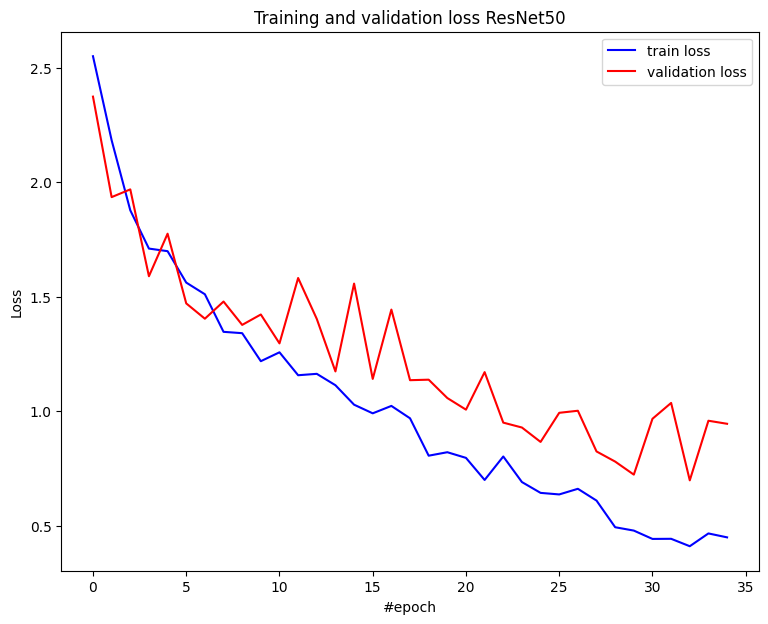

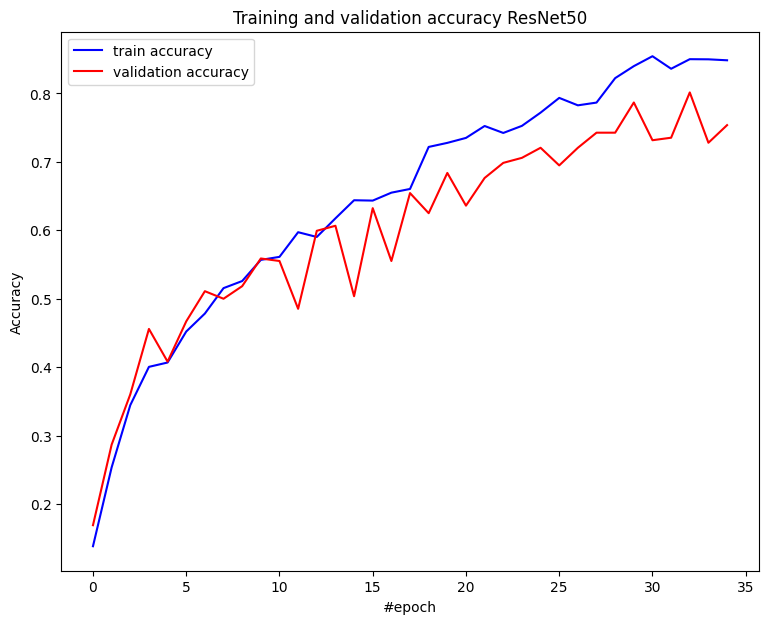

Current loss: 0.449574 Current validation loss: 0.945257
Current accuracy: 0.848430 Current validation accuracy: 0.753676


In [ ]:
event_loop(name='ResNet50', net=model_base, train_loader=train_dataloader, val_loader=test_dataloader, optimizer=opt, n_epoch=n_epoch, criterion=loss_func)

In [ ]:
torch.save(model_base, './model_base.pth')

# model_base = torch.load('./model_base.pth')
# model_base.eval()

Вывод: как видно модель не переучилась, обучалась корректно, возможно стоило бы добавить побольше эпох или сделать побольше lr

#### ResNet50, SGD, lr=0.005
Рассмотрим вторую модель, количество эпох = 40

In [ ]:
model_base_lr0005 = ResNet50(NUM_CLASSES).to(device)

In [ ]:
opt = torch.optim.SGD(model_base_lr0005.parameters(), lr=0.005, momentum=0.9)
n_epoch = 40
optimizer_state = {}
loss_func = nn.CrossEntropyLoss()

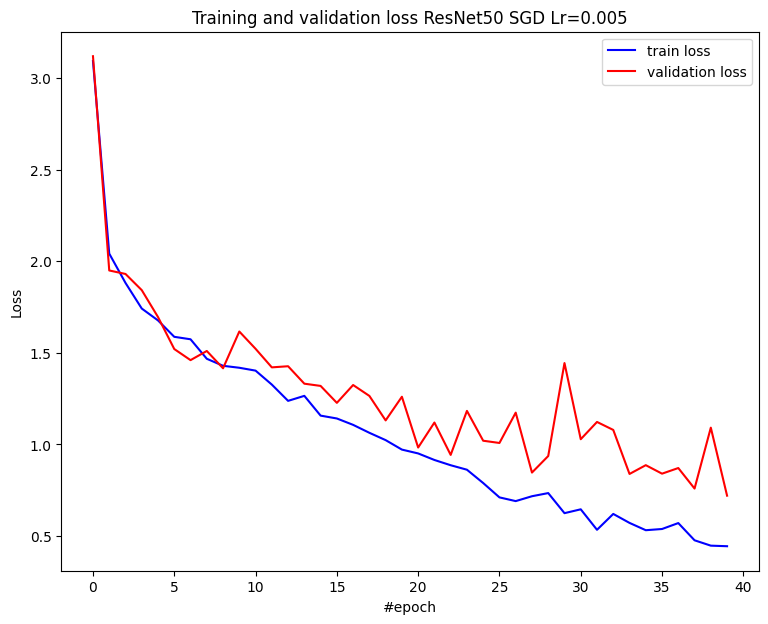

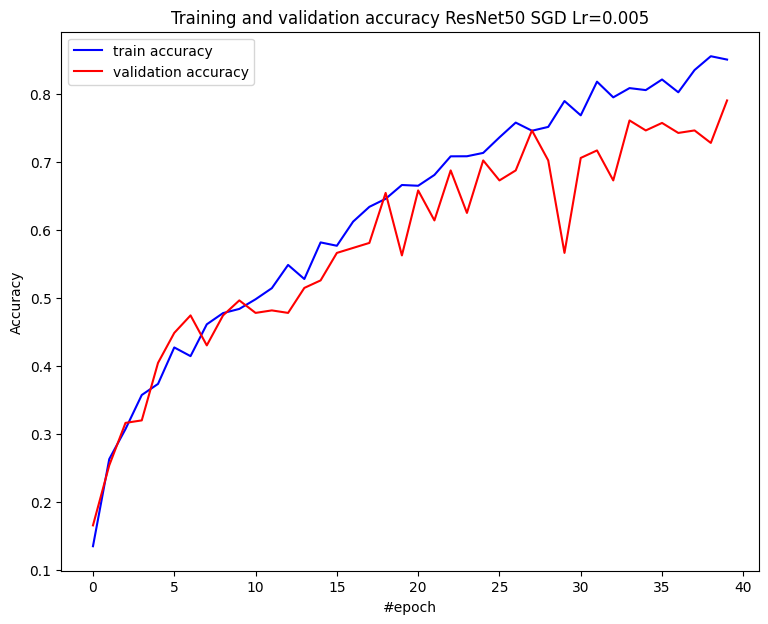

Current loss: 0.444799 Current validation loss: 0.720643
Current accuracy: 0.850543 Current validation accuracy: 0.790441


In [ ]:
event_loop(name='ResNet50 SGD Lr=0.005', net=model_base_lr0005, train_loader=train_dataloader, val_loader=test_dataloader, optimizer=opt, n_epoch=n_epoch, criterion=loss_func)

In [ ]:
torch.save(model_base_lr0005, './model_base_lr0005.pth')

# model_base_lr0005 = torch.load('./model_base_lr0005.pth')
# model_base_lr0005.eval()

Вывод: И правда, чуть больший lr помог достичь большего accuracy

#### ResNet50, Adam, lr=0.001
Рассмотрим третью модель, количество эпох = 40

In [ ]:
model_base_adam_0001 = ResNet50(NUM_CLASSES).to(device)

In [ ]:
opt = torch.optim.Adam(model_base_adam_0001.parameters(), lr=0.001, betas=(0.99, 0.99), eps=1e-5)
n_epoch = 40
optimizer_state = {}
loss_func = nn.CrossEntropyLoss()

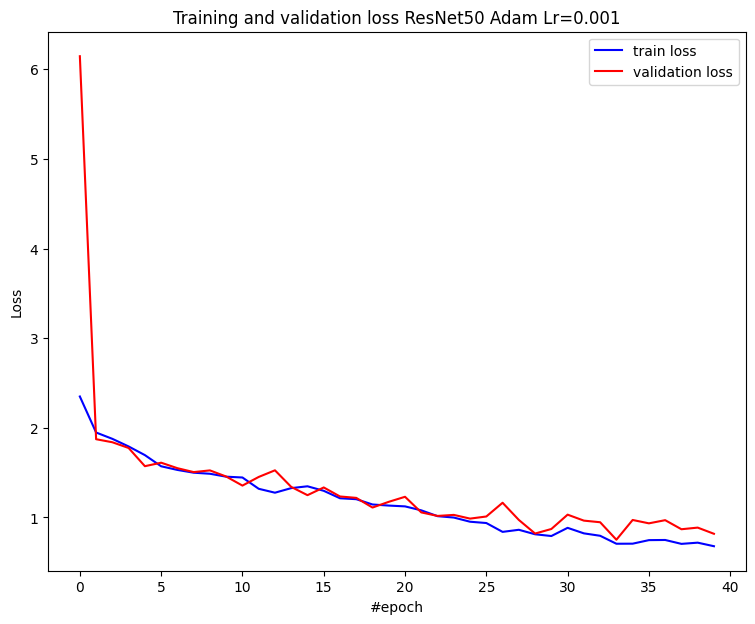

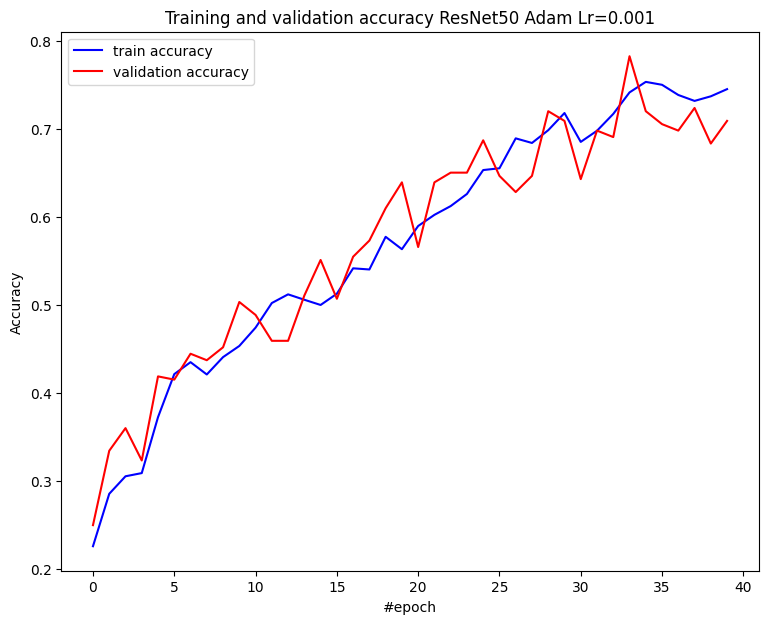

Current loss: 0.678479 Current validation loss: 0.817242
Current accuracy: 0.745672 Current validation accuracy: 0.709559


In [ ]:
event_loop(name='ResNet50 Adam Lr=0.001', net=model_base_adam_0001, train_loader=train_dataloader, val_loader=test_dataloader, optimizer=opt, n_epoch=n_epoch, criterion=loss_func)

In [ ]:
torch.save(model_base_adam_0001, './model_base_adam_0001.pth')

# model_base_adam_0001 = torch.load('./model_base_adam_0001.pth')
# model_base_adam_0001.eval()

Вывод: оптимизатор Adam ускорил процесс достижения хорошей accuracy в начале трейна, но не достиг к концу такого хорошего результата как SGD

### Metrics of best model
По качеству лучшая модель оказалась с SGD оптимизатором и lr=0.005  
На трейне:  
Current loss: 0.444799 Current validation loss: 0.720643  
Current accuracy: 0.850543 Current validation accuracy: 0.790441

In [ ]:
best_model = model_base_lr0005

Для этой модели посмотрим на confusion_matrix & classification_report

In [ ]:
# get all the predictions for the entire validation set
def get_all_preds(model, loader):
    all_preds = torch.tensor([])
    model.eval()

    for images, labels in loader:
        images = images.to(device)
        labels = labels.to(device)
        preds = model.forward(images)
        all_preds = torch.cat((all_preds, preds.cpu()), dim=0)

    return all_preds

In [ ]:
with torch.no_grad():
    test_preds = get_all_preds(best_model, test_dataloader)
    print(test_preds.shape)

print('true labels: ', valid_data.targets)
print('pred labels: ', torch.argmax(torch.softmax(test_preds, dim=1), dim=1).numpy())

/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


torch.Size([272, 10])
true labels:  [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9]
pred labels:  [9 0 0 0 9 0 0 0 0 0 0 9 9 0 0 0 0 3 0 0 0 0 0 9 0 9 1 1 1 4 1 1 1 1 1 1 1
 5 1 1 9 1 1 1 1 5 4 1 1 9 5 1 1 1 2 8 2 2 2 2 2 2 2 2 2 2

In [ ]:
from sklearn.metrics import confusion_matrix

cf_matrix = confusion_matrix(valid_data.targets, torch.argmax(torch.softmax(test_preds, dim=1), dim=1))
print(cf_matrix)

[[19  0  0  1  0  0  0  0  0  6]
 [ 0 21  0  0  2  3  0  0  0  2]
 [ 0  0 25  0  0  1  0  0  1  0]
 [ 0  0  2 25  2  0  0  0  1  0]
 [ 1  0  0  0 24  1  0  0  0  0]
 [ 4  0  1  1  1 19  0  0  0  2]
 [ 0  1  0  2  1  1 20  1  0  0]
 [ 0  0  0  0  7  1  0 19  1  0]
 [ 2  0  0  0  4  0  0  0 21  0]
 [ 3  0  0  0  0  1  0  0  0 22]]


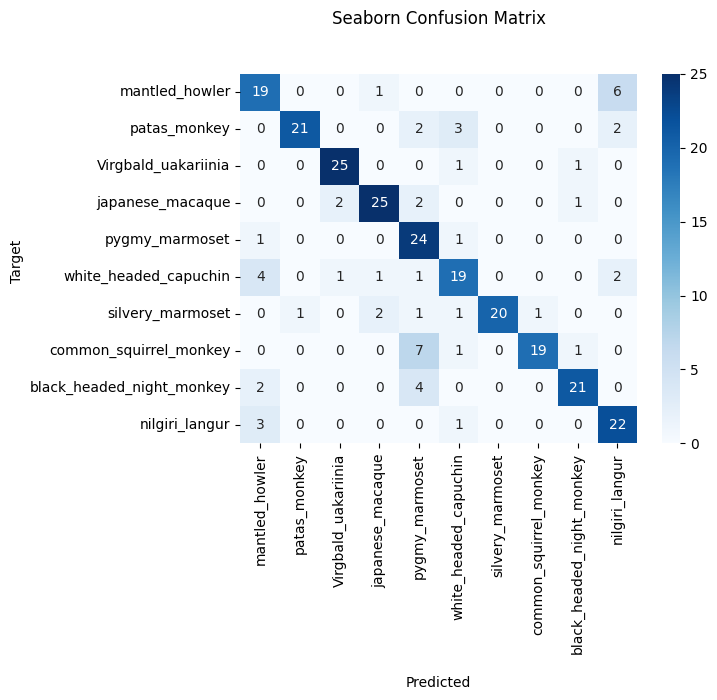

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

target_names = ['mantled_howler','patas_monkey','Virgbald_uakariinia','japanese_macaque','pygmy_marmoset','white_headed_capuchin','silvery_marmoset','common_squirrel_monkey','black_headed_night_monkey','nilgiri_langur']

ax = sns.heatmap(cf_matrix, annot=True, cmap='Blues')

ax.set_title('Seaborn Confusion Matrix\n\n');
ax.set_xlabel('\nPredicted')
ax.set_ylabel('Target ')

ax.xaxis.set_ticklabels(target_names, rotation=90)
ax.yaxis.set_ticklabels(target_names, rotation=0)

plt.show()

In [ ]:
from sklearn.metrics import classification_report

print(classification_report(valid_data.targets, torch.argmax(torch.softmax(test_preds, dim=1), dim=1).numpy(), target_names=target_names))

                           precision    recall  f1-score   support

           mantled_howler       0.66      0.73      0.69        26
             patas_monkey       0.95      0.75      0.84        28
      Virgbald_uakariinia       0.89      0.93      0.91        27
         japanese_macaque       0.86      0.83      0.85        30
           pygmy_marmoset       0.59      0.92      0.72        26
    white_headed_capuchin       0.70      0.68      0.69        28
         silvery_marmoset       1.00      0.77      0.87        26
   common_squirrel_monkey       0.95      0.68      0.79        28
black_headed_night_monkey       0.88      0.78      0.82        27
           nilgiri_langur       0.69      0.85      0.76        26

                 accuracy                           0.79       272
                macro avg       0.82      0.79      0.79       272
             weighted avg       0.82      0.79      0.79       272



#### Вывод  
По матрице видно, что модель в целом правильно предсказывала класс, но есть несколько классов, где она часто ошибается. Это так же видно и из classification_report: для mantled_howler, pygmy_marmoset, nilgiri_langur (f1_score < 0.80) модель выучилась хуже всего. Но например есть классы под которые она заучилась идеально: silvery_marmoset (возможно это связано с хорошими данными на трейне или более выразительными чертами обезьян данного класса)  
Модель побила baseline, и показала хорошие адекватные результаты на test

## Pretrained models  
Посмотрим на предобученные модели:  
#### ResNet50, ResNet101, ResNeXt  
Они должны дать качество лучше, потому что обучались на большем количестве данных и на большем количестве эпох

#### ResNet50  
Нам нужно зафайнтьюнить модель, для этого заменим последний слой на нужный нам (количество классов = 10) и будем обучать только его, а веса остальных слоев зафиксируем через requires_grad = False

In [ ]:
from torchvision.models import resnet50, ResNet50_Weights

# Flag for feature extracting. When False, we finetune the whole model,
#   when True we only update the reshaped layer params
feature_extract = True

def set_parameter_requires_grad(model, feature_extracting):
    if feature_extracting:
        for param in model.parameters():
            param.requires_grad = False

In [ ]:

weights = ResNet50_Weights.DEFAULT
model_resnet50 = resnet50(weights=weights)
set_parameter_requires_grad(model_resnet50, feature_extract)
# замена последнего слоя
model_resnet50.fc = torch.nn.Linear(model_resnet50.fc.in_features, out_features=NUM_CLASSES)
model_resnet50 = model_resnet50.to(device)
model_resnet50

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 

In [ ]:
opt = torch.optim.SGD(model_resnet50.parameters(), lr=0.001, momentum=0.9)
n_epoch = 25
optimizer_state = {}
loss_func = nn.CrossEntropyLoss()

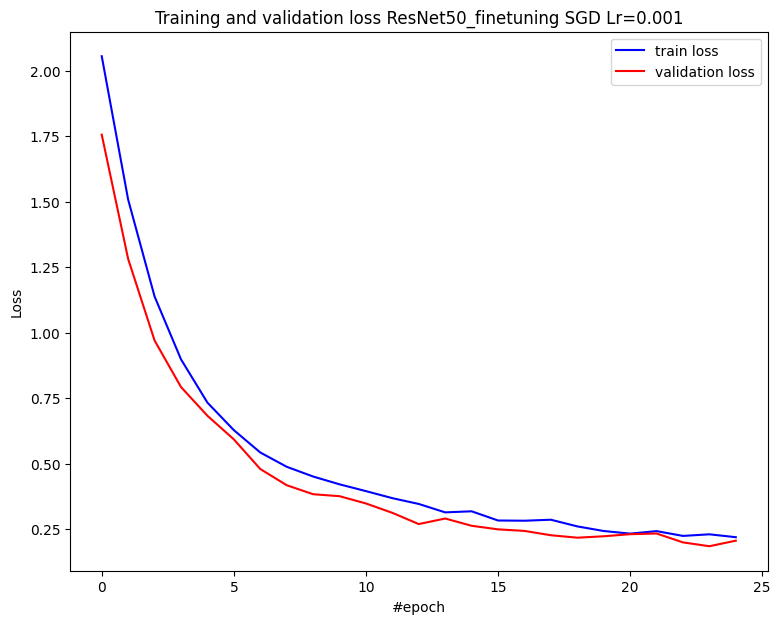

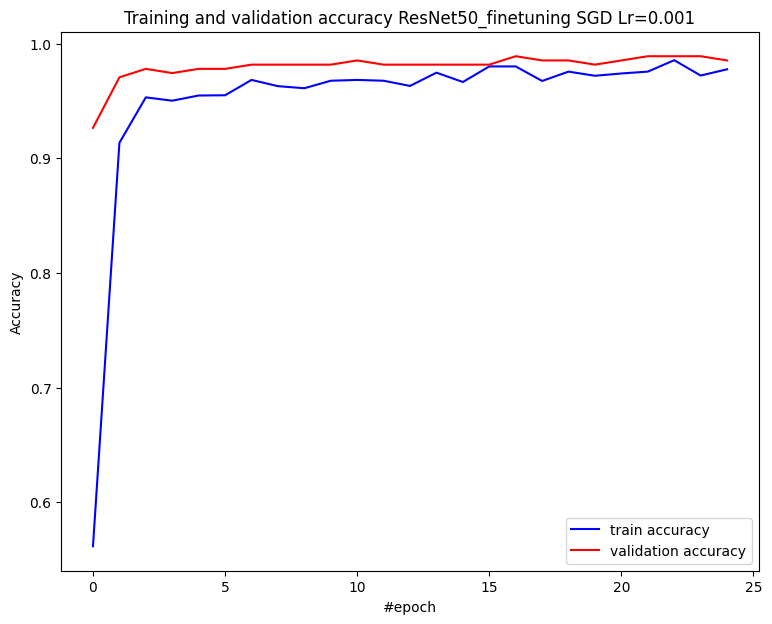

Current loss: 0.219247 Current validation loss: 0.205962
Current accuracy: 0.977556 Current validation accuracy: 0.985294


In [ ]:
event_loop(name='ResNet50_finetuning SGD Lr=0.001', net=model_resnet50, train_loader=train_dataloader, val_loader=test_dataloader, optimizer=opt, n_epoch=n_epoch, criterion=loss_func)

In [ ]:
torch.save(model_resnet50, './model_resnet50.pth')

# model_resnet50 = torch.load('./model_resnet50.pth')
# model_resnet50.eval()

Вывод: качество и правда в разы лучше (accuracy 0.985294 vs 0.790441), переобучения не достигли, значит выбрано верное колчество эпох и lr

#### ResNet101  
Проделаем те же манипуляции с другой моделью

In [ ]:
from torchvision.models import resnet101, ResNet101_Weights

feature_extract = True

weights = ResNet101_Weights.DEFAULT
model_resnet101 = resnet101(weights=weights)
set_parameter_requires_grad(model_resnet101, feature_extract)
model_resnet101.fc = torch.nn.Linear(model_resnet101.fc.in_features, out_features=NUM_CLASSES)
model_resnet101 = model_resnet101.to(device)
model_resnet101

Downloading: "https://download.pytorch.org/models/resnet101-cd907fc2.pth" to /root/.cache/torch/hub/checkpoints/resnet101-cd907fc2.pth
100%|██████████| 171M/171M [00:01<00:00, 97.5MB/s]


ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 

In [ ]:
opt = torch.optim.SGD(model_resnet101.parameters(), lr=0.001, momentum=0.9)
n_epoch = 25
optimizer_state = {}
loss_func = nn.CrossEntropyLoss()

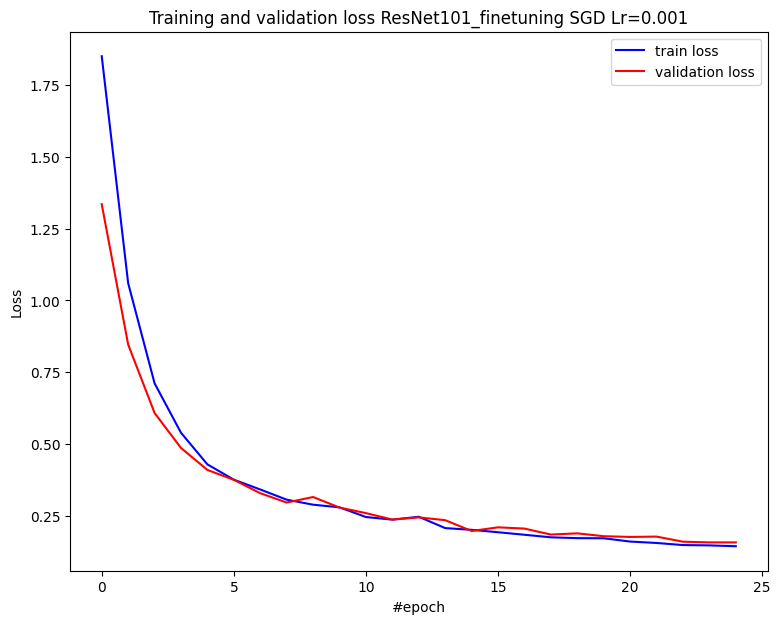

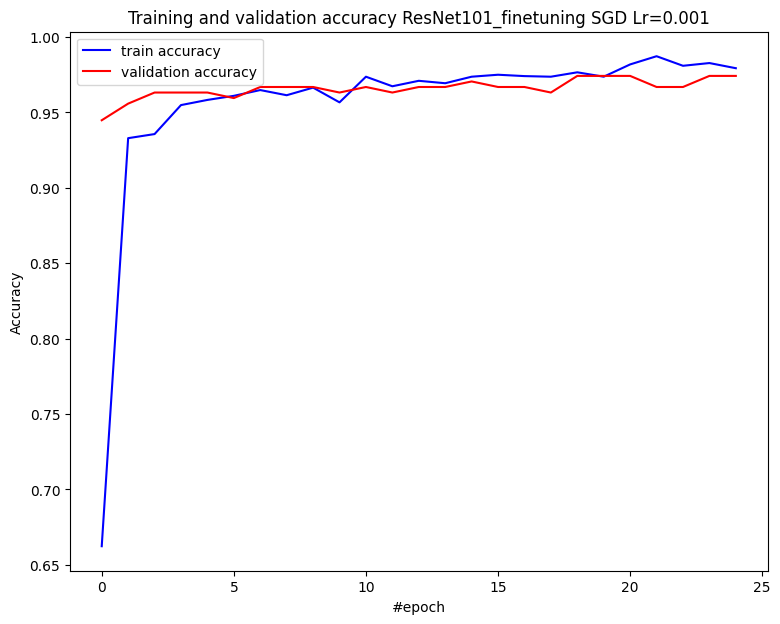

Current loss: 0.143579 Current validation loss: 0.156899
Current accuracy: 0.979368 Current validation accuracy: 0.974265


In [ ]:
event_loop(name='ResNet101_finetuning SGD Lr=0.001', net=model_resnet101, train_loader=train_dataloader, val_loader=test_dataloader, optimizer=opt, n_epoch=n_epoch, criterion=loss_func)

In [ ]:
torch.save(model_resnet101, './model_resnet101.pth')

# model_resnet101 = torch.load('./model_resnet101.pth')
# model_resnet101.eval()

Вывод: данная модель так же хорошо обучилась, loss стал даже меньше, чем у предыдущей

#### EfficientNet_V2  
Рассмотрим другое семейство моделей для сравнения

In [ ]:
from torchvision.models import efficientnet_v2_m, EfficientNet_V2_M_Weights

feature_extract = True

weights = EfficientNet_V2_M_Weights.DEFAULT
model_efficientnet = efficientnet_v2_m(weights=weights)
set_parameter_requires_grad(model_efficientnet, feature_extract)
model_efficientnet.classifier[1] = torch.nn.Linear(model_efficientnet.classifier[1].in_features, out_features=NUM_CLASSES)
model_efficientnet = model_efficientnet.to(device)
model_efficientnet

EfficientNet(
  (features): Sequential(
    (0): Conv2dNormActivation(
      (0): Conv2d(3, 24, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(24, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
      (2): SiLU(inplace=True)
    )
    (1): Sequential(
      (0): FusedMBConv(
        (block): Sequential(
          (0): Conv2dNormActivation(
            (0): Conv2d(24, 24, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
            (1): BatchNorm2d(24, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
            (2): SiLU(inplace=True)
          )
        )
        (stochastic_depth): StochasticDepth(p=0.0, mode=row)
      )
      (1): FusedMBConv(
        (block): Sequential(
          (0): Conv2dNormActivation(
            (0): Conv2d(24, 24, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
            (1): BatchNorm2d(24, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
  

In [ ]:
opt = torch.optim.SGD(model_efficientnet.parameters(), lr=0.001, momentum=0.9)
n_epoch = 25
optimizer_state = {}
loss_func = nn.CrossEntropyLoss()

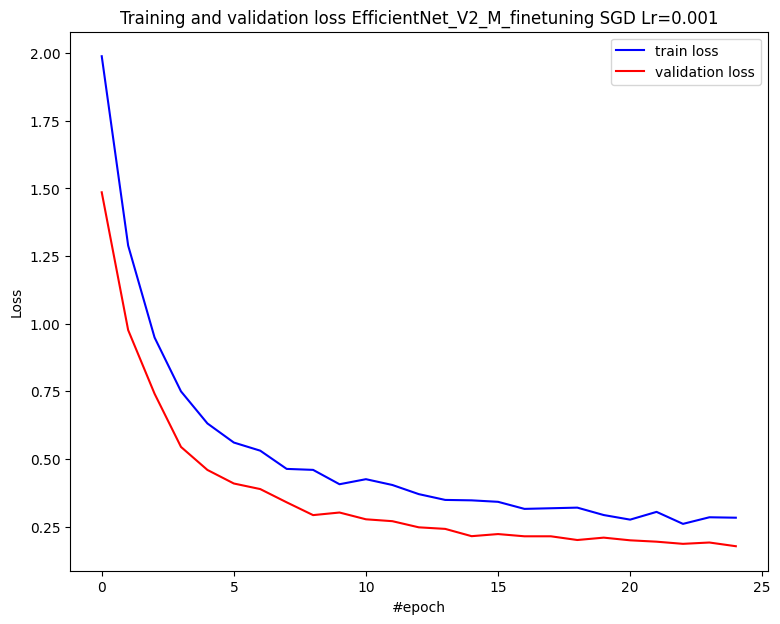

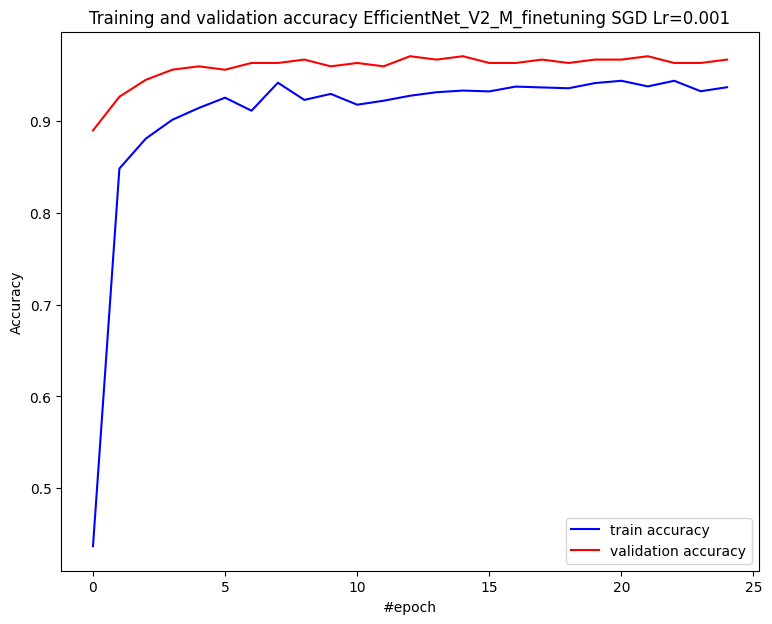

Current loss: 0.283253 Current validation loss: 0.177867
Current accuracy: 0.936795 Current validation accuracy: 0.966912


In [ ]:
event_loop(name='EfficientNet_V2_M_finetuning SGD Lr=0.001', net=model_efficientnet, train_loader=train_dataloader, val_loader=test_dataloader, optimizer=opt, n_epoch=n_epoch, criterion=loss_func)

In [ ]:
torch.save(model_efficientnet, './model_efficientnet.pth')

# model_efficientnet = torch.load('./model_efficientnet.pth')
# model_efficientnet.eval()

Вывод: данная модель показала качество хуже всех из трех, значит данных тип моделей не очень подходит под нашу задачу

### Metrics of best model

Лучшая модель по графикам обучения, loss, accuracy - ResNet101

In [ ]:
best_pretrained_model = model_resnet101

Построим для нее confusion_matrix & classification_report

In [ ]:
with torch.no_grad():
    test_preds = get_all_preds(best_pretrained_model, test_dataloader)
    print(test_preds.shape)

print('true labels: ', valid_data.targets)
print('pred labels: ', torch.argmax(torch.softmax(test_preds, dim=1), dim=1).numpy())

/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


torch.Size([272, 10])
true labels:  [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9]
pred labels:  [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 2 2 2 2 2 2 2 2 2 2 2 2

In [ ]:
from sklearn.metrics import confusion_matrix

cf_matrix = confusion_matrix(valid_data.targets, torch.argmax(torch.softmax(test_preds, dim=1), dim=1))
print(cf_matrix)

[[26  0  0  0  0  0  0  0  0  0]
 [ 0 28  0  0  0  0  0  0  0  0]
 [ 0  0 27  0  0  0  0  0  0  0]
 [ 0  2  0 28  0  0  0  0  0  0]
 [ 0  0  0  0 26  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0  2]
 [ 0  0  0  0  0  0 25  1  0  0]
 [ 0  0  0  0  0  0  0 28  0  0]
 [ 0  0  0  0  0  0  0  1 26  0]
 [ 0  0  0  0  1  0  0  0  0 25]]


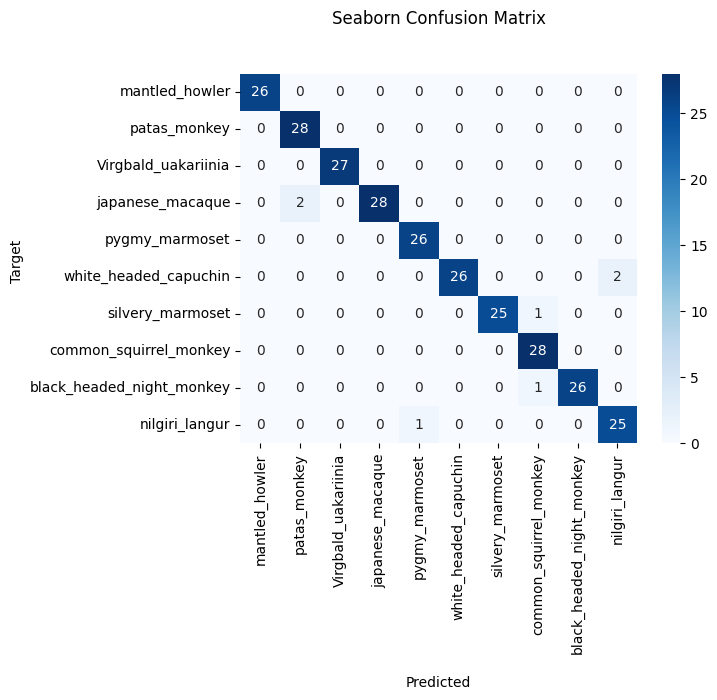

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

target_names = ['mantled_howler','patas_monkey','Virgbald_uakariinia','japanese_macaque','pygmy_marmoset','white_headed_capuchin','silvery_marmoset','common_squirrel_monkey','black_headed_night_monkey','nilgiri_langur']

ax = sns.heatmap(cf_matrix, annot=True, cmap='Blues')

ax.set_title('Seaborn Confusion Matrix\n\n');
ax.set_xlabel('\nPredicted')
ax.set_ylabel('Target ')

ax.xaxis.set_ticklabels(target_names, rotation=90)
ax.yaxis.set_ticklabels(target_names, rotation=0)

plt.show()

In [ ]:
from sklearn.metrics import classification_report

print(classification_report(valid_data.targets, torch.argmax(torch.softmax(test_preds, dim=1), dim=1).numpy(), target_names=target_names))

                           precision    recall  f1-score   support

           mantled_howler       1.00      1.00      1.00        26
             patas_monkey       0.93      1.00      0.97        28
      Virgbald_uakariinia       1.00      1.00      1.00        27
         japanese_macaque       1.00      0.93      0.97        30
           pygmy_marmoset       0.96      1.00      0.98        26
    white_headed_capuchin       1.00      0.93      0.96        28
         silvery_marmoset       1.00      0.96      0.98        26
   common_squirrel_monkey       0.93      1.00      0.97        28
black_headed_night_monkey       1.00      0.96      0.98        27
           nilgiri_langur       0.93      0.96      0.94        26

                 accuracy                           0.97       272
                macro avg       0.98      0.97      0.97       272
             weighted avg       0.98      0.97      0.97       272



#### Вывод:  
Finetunning реально сильная и полезная вещь, потому что мы смогли достичь лучшего результата, обучая уже предобученную модель под свою задачу  
Итого, лучшая модель угадывает правильно почти все классы, делает намного меньше ошибок (что видно по confusion matrix) если сравнивать с нашей реализацией. Так же у всех классов f1-score > 0.90, но проблемные классы в прошлой модели остались и в этой проблемными, но уже с более хорошими результатами

# Summary

# ДЗ 2.2. Object detection. 8 баллов.

Здесь я прошу вас воспользоваться популярным фреймворком для задачи object detection - YOLOv8. Но, если хотите, можете поиграться с моделями из mmdetection например, или запустить детекцию на DETR. Тоже будет оценено. YOLOv8 выбран как самый простой и удобный вариант. Ссылка на гитхаб и документацию - https://github.com/ultralytics/ultralytics.

Вам требуется поставить фреймворк, обучить модель детекции на данных, вывести графики лоссов и метрики на тестовом датасете. Покажите предсказания модели на 10 примерах из тестового набора данных. В этом задании не будет оцениваться каждый пункт по отдельности, а только вся проведенная работа в целом.

Обучать лучше на GPU, но на CPU тоже возможно. Маленькая версия YOLO с ресайзом до 320 у меня обучалась около 40 минут на CPU. Данные нужно скачать отсюда - https://public.roboflow.com/object-detection/oxford-pets/1/download/yolov8 (скачайте в формате YOLO). Имейте ввиду, что вам скорее всего нужно будет поменять пути в `data.yaml`, поставив абсолютные пути до папок. Например:

`train: /Users/mark/Desktop/Update820/train` и т.д.

In [1]:
!pip install ultralytics

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 750.4/750.4 kB 9.1 MB/s eta 0:00:00
  Using cached nvidia_cuda_nvrtc_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (23.7 MB)
  Using cached nvidia_cuda_runtime_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (823 kB)
  Using cached nvidia_cuda_cupti_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (14.1 MB)
  Using cached nvidia_cudnn_cu12-8.9.2.26-py3-none-manylinux1_x86_64.whl (731.7 MB)
  Using cached nvidia_cublas_cu12-12.1.3.1-py3-none-manylinux1_x86_64.whl (410.6 MB)
  Using cached nvidia_cufft_cu12-11.0.2.54-py3-none-manylinux1_x86_64.whl (121.6 MB)
  Using cached nvidia_curand_cu12-10.3.2.106-py3-none-manylinux1_x86_64.whl (56.5 MB)
  Using cached nvidia_cusolver_cu12-11.4.5.107-py3-none-manylinux1_x86_64.whl (124.2 MB)
  Using cached nvidia_cusparse_cu12-12.1.0.106-py3-none-manylinux1_x86_64.whl (196.0 MB)
  Using cached nvidia_nccl_cu12-2.19.3-py3-none-manylinux1_x86_64.whl (166.0 MB)
  Using cached nvidia_nvtx_cu12-12.1.105-py3-none-many

Скачаем датасет

In [1]:
!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="****************")
project = rf.workspace("brad-dwyer").project("oxford-pets")
dataset = project.version(1).download("yolov8")

loading Roboflow workspace...
loading Roboflow project...
Dependency ultralytics==8.0.196 is required but found version=8.1.47, to fix: `pip install ultralytics==8.0.196`


In [2]:
%load_ext tensorboard

In [3]:
import locale
locale.getpreferredencoding = lambda: "UTF-8"

Обучение модели: графики можно наблюдать в tensorflow

In [4]:
from ultralytics import YOLO

# Load a model
model_yolo = YOLO("yolov8n.yaml")  # build a new model from scratch
#model_yolo = YOLO("yolov8n.pt") #almost done

# Train the model
model_yolo.train(data="/content/Oxford-Pets-1/data.yaml", epochs=150, patience=20, plots=True, save_period=10)  # train the model
#model_yolo.train(resume=True)


Ultralytics YOLOv8.1.47 🚀 Python-3.10.12 torch-2.2.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov8n.yaml, data=/content/Oxford-Pets-1/data.yaml, epochs=150, time=None, patience=20, batch=16, imgsz=640, save=True, save_period=10, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=Tru

100%|██████████| 755k/755k [00:00<00:00, 41.9MB/s]


Overriding model.yaml nc=80 with nc=37

                   from  n    params  module                                       arguments                     
  0                  -1  1       464  ultralytics.nn.modules.conv.Conv             [3, 16, 3, 2]                 
  1                  -1  1      4672  ultralytics.nn.modules.conv.Conv             [16, 32, 3, 2]                
  2                  -1  1      7360  ultralytics.nn.modules.block.C2f             [32, 32, 1, True]             
  3                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  4                  -1  2     49664  ultralytics.nn.modules.block.C2f             [64, 64, 2, True]             
  5                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  6                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  7                  -1  1    295424  ultralytic

100%|██████████| 6.23M/6.23M [00:00<00:00, 175MB/s]


AMP: checks passed ✅


train: Scanning /content/Oxford-Pets-1/train/labels... 2576 images, 0 backgrounds, 0 corrupt: 100%|██████████| 2576/2576 [00:01<00:00, 1898.76it/s]

train: New cache created: /content/Oxford-Pets-1/train/labels.cache


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
val: Scanning /content/Oxford-Pets-1/valid/labels... 736 images, 0 backgrounds, 0 corrupt: 100%|██████████| 736/736 [00:00<00:00, 740.33it/s]

val: New cache created: /content/Oxford-Pets-1/valid/labels.cache


Plotting labels to runs/detect/train/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.000244, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/train
Starting training for 150 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/150      2.62G      2.923      5.825      4.193         37        640: 100%|██████████| 161/161 [00:59<00:00,  2.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:07<00:00,  3.11it/s]

                   all        736        738          0          0          0          0



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/150      2.29G       2.88      5.748      4.032         38        640: 100%|██████████| 161/161 [00:52<00:00,  3.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:06<00:00,  3.53it/s]

                   all        736        738   3.67e-05     0.0101   3.72e-05   1.68e-05



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/150      2.31G      2.777      5.629      3.653         44        640: 100%|██████████| 161/161 [00:52<00:00,  3.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:05<00:00,  3.98it/s]

                   all        736        738   0.000489     0.0934   0.000554   0.000148



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/150      2.31G      2.652      5.356      3.284         36        640: 100%|██████████| 161/161 [00:51<00:00,  3.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:07<00:00,  3.24it/s]

                   all        736        738    0.00259       0.37    0.00822    0.00315



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/150      2.31G      2.403      4.998      2.956         32        640: 100%|██████████| 161/161 [00:51<00:00,  3.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:05<00:00,  3.93it/s]

                   all        736        738    0.00578      0.418     0.0154    0.00647



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/150      2.31G      2.141      4.672      2.687         40        640: 100%|██████████| 161/161 [00:51<00:00,  3.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:07<00:00,  3.26it/s]


                   all        736        738      0.208     0.0461     0.0292     0.0128

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/150      2.31G      1.966      4.416      2.509         27        640: 100%|██████████| 161/161 [00:50<00:00,  3.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:06<00:00,  3.47it/s]

                   all        736        738      0.101     0.0237     0.0344     0.0165



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/150      2.31G       1.86      4.215      2.413         34        640: 100%|██████████| 161/161 [00:50<00:00,  3.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:05<00:00,  3.90it/s]

                   all        736        738      0.113      0.066     0.0447     0.0221



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/150      2.31G      1.786      4.083      2.315         32        640: 100%|██████████| 161/161 [00:50<00:00,  3.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:07<00:00,  3.28it/s]

                   all        736        738       0.17      0.073     0.0582     0.0324



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/150      2.31G      1.713      3.976      2.253         33        640: 100%|██████████| 161/161 [00:51<00:00,  3.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:05<00:00,  4.10it/s]

                   all        736        738       0.19     0.0614     0.0679      0.037



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/150      2.31G      1.681      3.806      2.206         31        640: 100%|██████████| 161/161 [00:51<00:00,  3.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:07<00:00,  3.24it/s]

                   all        736        738      0.127      0.165      0.086     0.0488



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/150      2.31G      1.634      3.699      2.169         32        640: 100%|██████████| 161/161 [00:51<00:00,  3.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:05<00:00,  3.95it/s]

                   all        736        738      0.125      0.154      0.102     0.0591



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/150      2.31G      1.594      3.628      2.109         41        640: 100%|██████████| 161/161 [00:51<00:00,  3.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:06<00:00,  3.34it/s]

                   all        736        738      0.165      0.185      0.116     0.0696



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/150      2.31G      1.555      3.537      2.085         35        640: 100%|██████████| 161/161 [00:51<00:00,  3.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:05<00:00,  3.85it/s]

                   all        736        738      0.183      0.187      0.129     0.0769



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/150      2.31G      1.547      3.436      2.053         33        640: 100%|██████████| 161/161 [00:51<00:00,  3.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:06<00:00,  3.34it/s]

                   all        736        738      0.156      0.207      0.149     0.0928



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/150      2.31G      1.529      3.357      2.044         36        640: 100%|██████████| 161/161 [00:51<00:00,  3.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:06<00:00,  3.68it/s]

                   all        736        738      0.159      0.283       0.17      0.105



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/150      2.31G      1.477      3.239      2.001         38        640: 100%|██████████| 161/161 [00:51<00:00,  3.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:06<00:00,  3.56it/s]

                   all        736        738      0.194      0.292      0.191      0.123



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/150      2.31G      1.477      3.198      1.984         44        640: 100%|██████████| 161/161 [00:50<00:00,  3.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:06<00:00,  3.40it/s]

                   all        736        738       0.24       0.25      0.188       0.12



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/150      2.31G      1.446      3.119      1.964         36        640: 100%|██████████| 161/161 [00:51<00:00,  3.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:05<00:00,  3.85it/s]

                   all        736        738        0.2       0.26      0.222      0.144



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/150      2.31G      1.423      3.032      1.935         34        640: 100%|██████████| 161/161 [00:50<00:00,  3.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:06<00:00,  3.35it/s]

                   all        736        738      0.225      0.325      0.251      0.164



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/150      2.31G      1.402      2.987      1.932         32        640: 100%|██████████| 161/161 [00:51<00:00,  3.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:06<00:00,  3.82it/s]

                   all        736        738      0.251      0.294       0.25      0.162



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/150      2.31G      1.395      2.924      1.908         28        640: 100%|██████████| 161/161 [00:51<00:00,  3.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:07<00:00,  3.24it/s]

                   all        736        738      0.311       0.34      0.287      0.193



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/150      2.31G      1.357      2.856      1.898         35        640: 100%|██████████| 161/161 [00:51<00:00,  3.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:05<00:00,  3.90it/s]

                   all        736        738      0.281      0.335       0.29        0.2



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/150      2.31G      1.346       2.79      1.865         30        640: 100%|██████████| 161/161 [00:50<00:00,  3.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:06<00:00,  3.31it/s]

                   all        736        738      0.311      0.351      0.317      0.214



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/150      2.31G      1.336      2.741      1.859         29        640: 100%|██████████| 161/161 [00:51<00:00,  3.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:06<00:00,  3.69it/s]

                   all        736        738      0.328      0.361      0.332      0.228



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/150      2.31G      1.317      2.694      1.859         31        640: 100%|██████████| 161/161 [00:51<00:00,  3.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:05<00:00,  3.86it/s]

                   all        736        738      0.327      0.353       0.34      0.228



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/150      2.31G      1.309      2.652      1.838         37        640: 100%|██████████| 161/161 [00:51<00:00,  3.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:06<00:00,  3.36it/s]


                   all        736        738      0.327      0.441      0.368      0.251

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/150      2.31G      1.314      2.623      1.835         29        640: 100%|██████████| 161/161 [00:51<00:00,  3.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:05<00:00,  3.91it/s]

                   all        736        738       0.33      0.394      0.331      0.226



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/150      2.31G      1.288      2.567       1.81         28        640: 100%|██████████| 161/161 [00:50<00:00,  3.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:06<00:00,  3.30it/s]

                   all        736        738      0.361      0.455      0.379      0.259



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/150      2.31G      1.286      2.531      1.809         41        640: 100%|██████████| 161/161 [00:51<00:00,  3.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:05<00:00,  4.06it/s]

                   all        736        738      0.373      0.427      0.391      0.271



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/150      2.31G       1.28       2.51      1.814         33        640: 100%|██████████| 161/161 [00:50<00:00,  3.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:06<00:00,  3.41it/s]

                   all        736        738      0.344       0.42      0.382      0.261



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/150      2.31G      1.247      2.482      1.769         32        640: 100%|██████████| 161/161 [00:50<00:00,  3.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:06<00:00,  3.45it/s]

                   all        736        738      0.367      0.489      0.429      0.296



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     33/150      2.31G      1.244      2.414      1.775         42        640: 100%|██████████| 161/161 [00:51<00:00,  3.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:05<00:00,  4.00it/s]

                   all        736        738      0.389      0.479      0.436      0.303



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     34/150      2.31G      1.244      2.413      1.772         30        640: 100%|██████████| 161/161 [00:50<00:00,  3.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:06<00:00,  3.36it/s]

                   all        736        738      0.398      0.434      0.437       0.31



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     35/150      2.31G      1.225       2.36      1.753         30        640: 100%|██████████| 161/161 [00:51<00:00,  3.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:05<00:00,  4.01it/s]

                   all        736        738      0.377      0.501      0.446      0.308



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/150      2.31G      1.232      2.329      1.754         42        640: 100%|██████████| 161/161 [00:52<00:00,  3.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:06<00:00,  3.30it/s]

                   all        736        738      0.387      0.506      0.467      0.322



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     37/150      2.31G      1.225      2.306      1.748         33        640: 100%|██████████| 161/161 [00:52<00:00,  3.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:05<00:00,  3.87it/s]


                   all        736        738      0.427      0.512      0.478      0.335

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     38/150      2.31G        1.2       2.28      1.729         40        640: 100%|██████████| 161/161 [00:52<00:00,  3.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:06<00:00,  3.35it/s]

                   all        736        738      0.444      0.497      0.488      0.341



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     39/150      2.31G      1.195      2.229      1.727         27        640: 100%|██████████| 161/161 [00:51<00:00,  3.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:05<00:00,  3.94it/s]

                   all        736        738      0.445      0.472      0.474      0.338



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     40/150      2.31G      1.186      2.196       1.72         30        640: 100%|██████████| 161/161 [00:51<00:00,  3.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:06<00:00,  3.38it/s]

                   all        736        738      0.423      0.539      0.498      0.351



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     41/150      2.31G      1.174      2.143      1.701         30        640: 100%|██████████| 161/161 [00:50<00:00,  3.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:06<00:00,  3.47it/s]

                   all        736        738      0.483      0.503       0.51      0.364



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     42/150      2.31G      1.162      2.144      1.691         39        640: 100%|██████████| 161/161 [00:51<00:00,  3.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:06<00:00,  3.49it/s]

                   all        736        738      0.452      0.499      0.493      0.354



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     43/150      2.31G      1.163      2.147      1.701         42        640: 100%|██████████| 161/161 [00:52<00:00,  3.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:06<00:00,  3.53it/s]

                   all        736        738      0.554       0.48      0.537      0.388



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     44/150      2.31G      1.144      2.103      1.676         34        640: 100%|██████████| 161/161 [00:52<00:00,  3.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:06<00:00,  3.60it/s]

                   all        736        738      0.457      0.549      0.547      0.395



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     45/150      2.31G      1.142      2.076      1.681         34        640: 100%|██████████| 161/161 [00:51<00:00,  3.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:07<00:00,  3.20it/s]

                   all        736        738      0.525      0.549      0.564      0.405



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     46/150      2.31G      1.158      2.087      1.686         37        640: 100%|██████████| 161/161 [00:52<00:00,  3.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:06<00:00,  3.38it/s]

                   all        736        738      0.405      0.566      0.505      0.362



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     47/150      2.31G      1.137      2.067      1.665         38        640: 100%|██████████| 161/161 [00:52<00:00,  3.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:05<00:00,  3.90it/s]

                   all        736        738       0.54      0.494      0.563      0.408



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     48/150      2.31G      1.144       2.06      1.681         43        640: 100%|██████████| 161/161 [00:52<00:00,  3.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:06<00:00,  3.29it/s]

                   all        736        738      0.485      0.564      0.574      0.415



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     49/150      2.31G      1.122      2.006      1.661         27        640: 100%|██████████| 161/161 [00:52<00:00,  3.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:05<00:00,  3.88it/s]

                   all        736        738      0.507      0.551      0.591      0.438



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     50/150      2.31G      1.108      1.967      1.651         31        640: 100%|██████████| 161/161 [00:52<00:00,  3.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:07<00:00,  3.26it/s]

                   all        736        738      0.523      0.579      0.575      0.422



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     51/150      2.31G      1.112      1.995      1.644         30        640: 100%|██████████| 161/161 [00:52<00:00,  3.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:05<00:00,  4.06it/s]

                   all        736        738      0.549      0.527      0.578      0.423



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     52/150      2.31G      1.097      1.949      1.632         29        640: 100%|██████████| 161/161 [00:52<00:00,  3.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:06<00:00,  3.32it/s]

                   all        736        738      0.505      0.595      0.594      0.434



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     53/150      2.31G        1.1      1.911      1.634         36        640: 100%|██████████| 161/161 [00:52<00:00,  3.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:06<00:00,  3.81it/s]

                   all        736        738      0.559      0.561      0.601      0.447



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     54/150      2.31G      1.079      1.899      1.615         32        640: 100%|██████████| 161/161 [00:52<00:00,  3.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:07<00:00,  3.28it/s]

                   all        736        738      0.527      0.623      0.611      0.459



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     55/150      2.31G      1.095      1.889      1.628         35        640: 100%|██████████| 161/161 [00:52<00:00,  3.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:05<00:00,  3.96it/s]

                   all        736        738      0.552      0.559      0.598      0.444



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     56/150      2.31G      1.071      1.893      1.616         39        640: 100%|██████████| 161/161 [00:52<00:00,  3.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:07<00:00,  3.24it/s]

                   all        736        738      0.556      0.605      0.627      0.469



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     57/150      2.31G      1.085      1.858      1.619         36        640: 100%|██████████| 161/161 [00:52<00:00,  3.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:06<00:00,  3.79it/s]

                   all        736        738      0.552      0.609      0.619      0.458



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     58/150      2.31G       1.07      1.852      1.611         29        640: 100%|██████████| 161/161 [00:52<00:00,  3.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:07<00:00,  3.28it/s]

                   all        736        738      0.555      0.625      0.643      0.476



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     59/150      2.31G      1.054      1.814      1.596         36        640: 100%|██████████| 161/161 [00:52<00:00,  3.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:05<00:00,  3.98it/s]

                   all        736        738      0.565       0.64      0.657      0.485



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     60/150      2.31G      1.079      1.844      1.614         29        640: 100%|██████████| 161/161 [00:52<00:00,  3.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:07<00:00,  3.22it/s]

                   all        736        738      0.572      0.625      0.639      0.478



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     61/150      2.31G      1.056      1.786      1.591         35        640: 100%|██████████| 161/161 [00:52<00:00,  3.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:05<00:00,  4.02it/s]

                   all        736        738      0.562      0.627      0.654      0.491



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     62/150      2.31G      1.056      1.784      1.592         36        640: 100%|██████████| 161/161 [00:52<00:00,  3.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:07<00:00,  3.22it/s]

                   all        736        738      0.535      0.618      0.647      0.486



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     63/150      2.31G       1.05       1.79       1.59         39        640: 100%|██████████| 161/161 [00:52<00:00,  3.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:05<00:00,  3.97it/s]

                   all        736        738      0.582      0.641       0.66      0.496



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     64/150      2.31G      1.046      1.752      1.583         34        640: 100%|██████████| 161/161 [00:52<00:00,  3.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:07<00:00,  3.27it/s]

                   all        736        738      0.606       0.63      0.661        0.5



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     65/150      2.31G      1.036      1.761      1.571         30        640: 100%|██████████| 161/161 [00:52<00:00,  3.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:05<00:00,  4.01it/s]

                   all        736        738      0.567      0.654      0.666      0.507



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     66/150      2.31G      1.042      1.765      1.577         34        640: 100%|██████████| 161/161 [00:52<00:00,  3.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:06<00:00,  3.31it/s]

                   all        736        738      0.583      0.644      0.673      0.509



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     67/150      2.31G      1.034      1.734      1.577         35        640: 100%|██████████| 161/161 [00:52<00:00,  3.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:06<00:00,  3.83it/s]

                   all        736        738      0.591      0.672      0.684       0.52



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     68/150      2.31G      1.026      1.699      1.561         37        640: 100%|██████████| 161/161 [00:52<00:00,  3.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:06<00:00,  3.40it/s]

                   all        736        738      0.614      0.667      0.695      0.526



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     69/150      2.31G      1.029      1.709      1.566         32        640: 100%|██████████| 161/161 [00:51<00:00,  3.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:05<00:00,  4.03it/s]

                   all        736        738      0.656       0.61       0.67       0.51



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     70/150      2.31G      1.012      1.701      1.545         40        640: 100%|██████████| 161/161 [00:51<00:00,  3.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:06<00:00,  3.39it/s]

                   all        736        738      0.598      0.664      0.679      0.518



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     71/150      2.31G      1.026      1.693      1.563         42        640: 100%|██████████| 161/161 [00:50<00:00,  3.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:05<00:00,  3.96it/s]

                   all        736        738      0.637      0.641       0.69      0.528



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     72/150      2.31G      1.016      1.667      1.555         28        640: 100%|██████████| 161/161 [00:50<00:00,  3.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:06<00:00,  3.47it/s]

                   all        736        738      0.614      0.642      0.687      0.524



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     73/150      2.31G      1.002      1.663      1.542         28        640: 100%|██████████| 161/161 [00:51<00:00,  3.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:05<00:00,  3.89it/s]

                   all        736        738      0.604      0.676      0.692      0.526



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     74/150      2.31G      1.006      1.651      1.544         37        640: 100%|██████████| 161/161 [00:51<00:00,  3.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:06<00:00,  3.33it/s]

                   all        736        738      0.663      0.617      0.696      0.531



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     75/150      2.31G      1.012      1.667      1.551         30        640: 100%|██████████| 161/161 [00:51<00:00,  3.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:05<00:00,  4.07it/s]

                   all        736        738      0.649      0.661      0.707      0.543



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     76/150      2.31G      0.995      1.616      1.527         35        640: 100%|██████████| 161/161 [00:52<00:00,  3.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:06<00:00,  3.46it/s]

                   all        736        738       0.66      0.643        0.7      0.541



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     77/150      2.31G     0.9797      1.596      1.524         34        640: 100%|██████████| 161/161 [00:52<00:00,  3.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:06<00:00,  3.32it/s]

                   all        736        738      0.695      0.632      0.726       0.56



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     78/150      2.31G     0.9892      1.607       1.53         37        640: 100%|██████████| 161/161 [00:52<00:00,  3.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:05<00:00,  3.96it/s]

                   all        736        738      0.663      0.692      0.729      0.564



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     79/150      2.31G      0.986      1.583      1.524         37        640: 100%|██████████| 161/161 [00:52<00:00,  3.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:06<00:00,  3.31it/s]

                   all        736        738      0.687      0.651      0.717       0.55



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     80/150      2.31G     0.9804      1.569      1.521         44        640: 100%|██████████| 161/161 [00:52<00:00,  3.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:06<00:00,  3.55it/s]

                   all        736        738      0.653      0.669      0.722      0.557



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     81/150      2.31G     0.9705      1.552      1.502         31        640: 100%|██████████| 161/161 [00:52<00:00,  3.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:05<00:00,  4.03it/s]

                   all        736        738      0.652      0.689      0.719       0.55



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     82/150      2.31G      0.976      1.538      1.507         41        640: 100%|██████████| 161/161 [00:51<00:00,  3.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:06<00:00,  3.29it/s]

                   all        736        738      0.636      0.684      0.716      0.549



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     83/150      2.31G     0.9706      1.554      1.511         29        640: 100%|██████████| 161/161 [00:52<00:00,  3.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:05<00:00,  3.95it/s]

                   all        736        738      0.645      0.692      0.724      0.561



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     84/150      2.31G     0.9698      1.563      1.507         35        640: 100%|██████████| 161/161 [00:52<00:00,  3.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:07<00:00,  3.23it/s]

                   all        736        738      0.662       0.67      0.731      0.567



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     85/150      2.31G     0.9603      1.536      1.503         33        640: 100%|██████████| 161/161 [00:52<00:00,  3.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:06<00:00,  3.64it/s]

                   all        736        738      0.645      0.686      0.728      0.556



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     86/150      2.31G     0.9799      1.544      1.524         32        640: 100%|██████████| 161/161 [00:52<00:00,  3.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:05<00:00,  4.00it/s]

                   all        736        738      0.627      0.686      0.717       0.55



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     87/150      2.31G     0.9753       1.53      1.505         31        640: 100%|██████████| 161/161 [00:52<00:00,  3.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:06<00:00,  3.37it/s]

                   all        736        738      0.674      0.681      0.728      0.566



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     88/150      2.31G     0.9646      1.509        1.5         32        640: 100%|██████████| 161/161 [00:52<00:00,  3.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:05<00:00,  3.95it/s]

                   all        736        738      0.728      0.642      0.742      0.576



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     89/150      2.31G     0.9518       1.51      1.492         38        640: 100%|██████████| 161/161 [00:51<00:00,  3.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:06<00:00,  3.44it/s]

                   all        736        738      0.628      0.715      0.741      0.576



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     90/150      2.31G     0.9428      1.471      1.493         35        640: 100%|██████████| 161/161 [00:51<00:00,  3.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:05<00:00,  3.96it/s]

                   all        736        738      0.621      0.722      0.734      0.573



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     91/150      2.31G      0.958      1.504      1.498         40        640: 100%|██████████| 161/161 [00:52<00:00,  3.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:06<00:00,  3.49it/s]

                   all        736        738      0.686      0.673      0.749      0.583



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     92/150      2.31G     0.9432      1.464       1.49         35        640: 100%|██████████| 161/161 [00:51<00:00,  3.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:07<00:00,  3.27it/s]

                   all        736        738      0.639      0.734      0.743      0.575



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     93/150      2.31G     0.9573       1.48      1.499         26        640: 100%|██████████| 161/161 [00:51<00:00,  3.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:05<00:00,  3.89it/s]

                   all        736        738      0.692      0.653      0.736      0.578



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     94/150      2.31G     0.9452      1.473       1.48         41        640: 100%|██████████| 161/161 [00:52<00:00,  3.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:06<00:00,  3.46it/s]

                   all        736        738      0.709      0.686      0.747       0.58



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     95/150      2.31G      0.946      1.456      1.487         32        640: 100%|██████████| 161/161 [00:51<00:00,  3.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:05<00:00,  4.03it/s]

                   all        736        738      0.675       0.68      0.744       0.58



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     96/150      2.31G     0.9362      1.458      1.476         34        640: 100%|██████████| 161/161 [00:52<00:00,  3.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:06<00:00,  3.42it/s]

                   all        736        738      0.688      0.695      0.755      0.591



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     97/150      2.31G     0.9312      1.439      1.473         40        640: 100%|██████████| 161/161 [00:52<00:00,  3.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:06<00:00,  3.57it/s]

                   all        736        738      0.669      0.725      0.752      0.589



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     98/150      2.31G     0.9261      1.435      1.467         35        640: 100%|██████████| 161/161 [00:51<00:00,  3.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:06<00:00,  3.56it/s]

                   all        736        738      0.697      0.684      0.759      0.594



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     99/150      2.31G     0.9167      1.399      1.465         41        640: 100%|██████████| 161/161 [00:52<00:00,  3.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:06<00:00,  3.37it/s]

                   all        736        738      0.662      0.728       0.76      0.597



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    100/150      2.31G     0.9305      1.427      1.465         32        640: 100%|██████████| 161/161 [00:52<00:00,  3.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:06<00:00,  3.83it/s]

                   all        736        738      0.651      0.731      0.759      0.602



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    101/150      2.31G     0.9268      1.402      1.464         27        640: 100%|██████████| 161/161 [00:52<00:00,  3.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:06<00:00,  3.32it/s]

                   all        736        738      0.694      0.707      0.756      0.599



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    102/150      2.31G     0.9247      1.366      1.467         32        640: 100%|██████████| 161/161 [00:52<00:00,  3.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:05<00:00,  4.01it/s]

                   all        736        738      0.703      0.686      0.758      0.593



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    103/150      2.31G     0.9311      1.425      1.466         37        640: 100%|██████████| 161/161 [00:53<00:00,  3.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:06<00:00,  3.60it/s]

                   all        736        738        0.7      0.682      0.758      0.596



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    104/150      2.31G     0.9083      1.374      1.454         33        640: 100%|██████████| 161/161 [00:51<00:00,  3.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:06<00:00,  3.34it/s]

                   all        736        738      0.677      0.744      0.768      0.602



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    105/150      2.31G     0.9066      1.367      1.448         37        640: 100%|██████████| 161/161 [00:52<00:00,  3.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:05<00:00,  3.93it/s]

                   all        736        738      0.711      0.693      0.764        0.6



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    106/150      2.31G     0.9254      1.383      1.465         27        640: 100%|██████████| 161/161 [00:51<00:00,  3.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:06<00:00,  3.34it/s]

                   all        736        738      0.712      0.717       0.77      0.605



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    107/150      2.31G     0.9067      1.382      1.443         30        640: 100%|██████████| 161/161 [00:51<00:00,  3.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:05<00:00,  4.14it/s]

                   all        736        738      0.693      0.714      0.765      0.603



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    108/150      2.31G     0.8955      1.337      1.444         39        640: 100%|██████████| 161/161 [00:51<00:00,  3.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:06<00:00,  3.29it/s]

                   all        736        738      0.661      0.754      0.768      0.603



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    109/150      2.31G     0.9041      1.364      1.445         37        640: 100%|██████████| 161/161 [00:52<00:00,  3.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:06<00:00,  3.65it/s]

                   all        736        738       0.73      0.699      0.776      0.607



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    110/150      2.31G     0.9014      1.352      1.434         33        640: 100%|██████████| 161/161 [00:52<00:00,  3.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:06<00:00,  3.72it/s]

                   all        736        738      0.701      0.716      0.773      0.608



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    111/150      2.31G     0.9008      1.348      1.444         35        640: 100%|██████████| 161/161 [00:52<00:00,  3.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:06<00:00,  3.30it/s]

                   all        736        738      0.734       0.69      0.771      0.608



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    112/150      2.31G     0.8913      1.338      1.428         45        640: 100%|██████████| 161/161 [00:51<00:00,  3.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:05<00:00,  3.86it/s]

                   all        736        738      0.727      0.702      0.772       0.61



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    113/150      2.31G     0.8924      1.329      1.439         38        640: 100%|██████████| 161/161 [00:51<00:00,  3.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:07<00:00,  3.27it/s]

                   all        736        738      0.728       0.71      0.776      0.614



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    114/150      2.31G     0.8921      1.335      1.439         38        640: 100%|██████████| 161/161 [00:51<00:00,  3.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:06<00:00,  3.78it/s]

                   all        736        738      0.717      0.711      0.782      0.616



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    115/150      2.31G     0.8846      1.311      1.434         31        640: 100%|██████████| 161/161 [00:52<00:00,  3.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:06<00:00,  3.31it/s]


                   all        736        738      0.711      0.721      0.779      0.614

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    116/150      2.31G     0.8946       1.33      1.429         35        640: 100%|██████████| 161/161 [00:51<00:00,  3.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:06<00:00,  3.45it/s]

                   all        736        738      0.706      0.734      0.781      0.617



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    117/150      2.31G     0.8838      1.315      1.428         32        640: 100%|██████████| 161/161 [00:52<00:00,  3.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:05<00:00,  3.94it/s]

                   all        736        738      0.743        0.7      0.786      0.619



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    118/150      2.31G     0.8914      1.311      1.432         40        640: 100%|██████████| 161/161 [00:52<00:00,  3.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:06<00:00,  3.29it/s]

                   all        736        738      0.702      0.733      0.782      0.619



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    119/150      2.31G     0.8857      1.303      1.431         41        640: 100%|██████████| 161/161 [00:52<00:00,  3.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:05<00:00,  3.95it/s]

                   all        736        738      0.722      0.723      0.784      0.621



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    120/150      2.31G     0.8826      1.305      1.428         33        640: 100%|██████████| 161/161 [00:52<00:00,  3.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:06<00:00,  3.38it/s]

                   all        736        738      0.712      0.717      0.774      0.615



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    121/150      2.31G     0.8675      1.281      1.411         28        640: 100%|██████████| 161/161 [00:52<00:00,  3.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:05<00:00,  4.05it/s]


                   all        736        738      0.745      0.703       0.78      0.619

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    122/150      2.31G     0.8674       1.29      1.417         33        640: 100%|██████████| 161/161 [00:51<00:00,  3.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:06<00:00,  3.38it/s]

                   all        736        738       0.74      0.702      0.777      0.617



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    123/150      2.31G     0.8697      1.282       1.41         38        640: 100%|██████████| 161/161 [00:51<00:00,  3.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:06<00:00,  3.81it/s]

                   all        736        738      0.718      0.705      0.778      0.616



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    124/150      2.31G     0.8625      1.276      1.413         39        640: 100%|██████████| 161/161 [00:51<00:00,  3.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:05<00:00,  3.85it/s]

                   all        736        738      0.741      0.684      0.781      0.619



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    125/150      2.31G     0.8668      1.263      1.412         38        640: 100%|██████████| 161/161 [00:50<00:00,  3.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:06<00:00,  3.30it/s]

                   all        736        738      0.693      0.739      0.784      0.622



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    126/150      2.31G     0.8577      1.263      1.396         37        640: 100%|██████████| 161/161 [00:51<00:00,  3.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:05<00:00,  3.86it/s]

                   all        736        738      0.714       0.73      0.786      0.621



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    127/150      2.31G     0.8644      1.251       1.41         36        640: 100%|██████████| 161/161 [00:51<00:00,  3.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:06<00:00,  3.37it/s]

                   all        736        738       0.71      0.744      0.789      0.624



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    128/150      2.31G     0.8746       1.29      1.428         34        640: 100%|██████████| 161/161 [00:51<00:00,  3.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:05<00:00,  4.05it/s]

                   all        736        738      0.712      0.748      0.791      0.627



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    129/150      2.31G     0.8646      1.247      1.401         30        640: 100%|██████████| 161/161 [00:51<00:00,  3.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:06<00:00,  3.39it/s]

                   all        736        738      0.768      0.687      0.786      0.623



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    130/150      2.31G     0.8557      1.254      1.394         37        640: 100%|██████████| 161/161 [00:51<00:00,  3.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:06<00:00,  3.81it/s]

                   all        736        738      0.778      0.696      0.787      0.628



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    131/150      2.31G      0.856      1.242      1.396         40        640: 100%|██████████| 161/161 [00:52<00:00,  3.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:06<00:00,  3.38it/s]

                   all        736        738      0.707      0.749      0.791      0.627



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    132/150      2.31G     0.8588      1.251      1.402         41        640: 100%|██████████| 161/161 [00:52<00:00,  3.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:06<00:00,  3.58it/s]

                   all        736        738      0.702      0.769       0.79      0.623



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    133/150      2.31G     0.8426      1.224      1.395         34        640: 100%|██████████| 161/161 [00:52<00:00,  3.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:05<00:00,  3.84it/s]

                   all        736        738       0.72       0.74       0.79      0.627



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    134/150      2.31G     0.8576      1.248      1.401         31        640: 100%|██████████| 161/161 [00:51<00:00,  3.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:06<00:00,  3.38it/s]


                   all        736        738      0.715      0.738      0.787      0.623

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    135/150      2.31G     0.8445       1.23      1.388         38        640: 100%|██████████| 161/161 [00:52<00:00,  3.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:05<00:00,  4.15it/s]

                   all        736        738      0.699      0.752      0.787      0.625



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    136/150      2.31G     0.8566      1.233      1.404         33        640: 100%|██████████| 161/161 [00:51<00:00,  3.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:06<00:00,  3.36it/s]

                   all        736        738      0.718      0.739       0.79      0.626



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    137/150      2.31G     0.8369      1.192      1.381         32        640: 100%|██████████| 161/161 [00:52<00:00,  3.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:05<00:00,  3.86it/s]

                   all        736        738      0.738      0.734      0.792      0.628



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    138/150      2.31G      0.851       1.23      1.405         36        640: 100%|██████████| 161/161 [00:52<00:00,  3.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:06<00:00,  3.82it/s]

                   all        736        738      0.753      0.708      0.792      0.628



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    139/150      2.31G     0.8463      1.235      1.401         35        640: 100%|██████████| 161/161 [00:52<00:00,  3.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:06<00:00,  3.35it/s]

                   all        736        738      0.714      0.731      0.789      0.626



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    140/150      2.31G     0.8506      1.213      1.389         42        640: 100%|██████████| 161/161 [00:52<00:00,  3.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:05<00:00,  3.96it/s]

                   all        736        738      0.714      0.737       0.79      0.626


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    141/150       2.6G     0.6661     0.8389      1.279         16        640: 100%|██████████| 161/161 [00:51<00:00,  3.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:06<00:00,  3.42it/s]

                   all        736        738      0.728      0.712       0.78      0.615



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    142/150      2.31G     0.6652     0.7945      1.282         16        640: 100%|██████████| 161/161 [00:49<00:00,  3.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:05<00:00,  4.01it/s]

                   all        736        738      0.734      0.711      0.784      0.618



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    143/150      2.31G     0.6564     0.7702      1.272         16        640: 100%|██████████| 161/161 [00:49<00:00,  3.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:05<00:00,  4.03it/s]

                   all        736        738       0.75      0.706      0.782      0.617



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    144/150      2.31G     0.6521     0.7708      1.268         16        640: 100%|██████████| 161/161 [00:49<00:00,  3.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:06<00:00,  3.32it/s]

                   all        736        738      0.771      0.701      0.785      0.619



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    145/150      2.31G     0.6505     0.7483      1.257         16        640: 100%|██████████| 161/161 [00:48<00:00,  3.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:05<00:00,  3.87it/s]

                   all        736        738      0.754      0.704      0.789      0.623



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    146/150      2.31G     0.6345     0.7453      1.251         16        640: 100%|██████████| 161/161 [00:49<00:00,  3.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:05<00:00,  3.91it/s]

                   all        736        738      0.724      0.718       0.79      0.624



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    147/150      2.31G     0.6421     0.7564      1.261         16        640: 100%|██████████| 161/161 [00:48<00:00,  3.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:06<00:00,  3.42it/s]

                   all        736        738      0.748      0.711       0.79      0.625



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    148/150      2.31G     0.6393     0.7498      1.258         16        640: 100%|██████████| 161/161 [00:48<00:00,  3.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:06<00:00,  3.81it/s]

                   all        736        738      0.757       0.71       0.79      0.626



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    149/150      2.31G     0.6447      0.741      1.252         16        640: 100%|██████████| 161/161 [00:49<00:00,  3.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:05<00:00,  3.94it/s]

                   all        736        738      0.764        0.7      0.787      0.624



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    150/150      2.31G     0.6426     0.7382      1.253         16        640: 100%|██████████| 161/161 [00:48<00:00,  3.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:06<00:00,  3.31it/s]

                   all        736        738      0.756      0.711      0.787      0.624



150 epochs completed in 2.445 hours.
Optimizer stripped from runs/detect/train/weights/last.pt, 6.3MB
Optimizer stripped from runs/detect/train/weights/best.pt, 6.3MB

Validating runs/detect/train/weights/best.pt...
Ultralytics YOLOv8.1.47 🚀 Python-3.10.12 torch-2.2.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLOv8n summary (fused): 168 layers, 3012863 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:08<00:00,  2.80it/s]


                   all        736        738      0.738      0.735      0.792      0.629
        cat-Abyssinian        736         17      0.847      0.654      0.799      0.715
            cat-Bengal        736         26       0.74      0.548      0.653       0.53
            cat-Birman        736         26      0.771      0.846      0.861      0.725
            cat-Bombay        736         24       0.85      0.833      0.919      0.812
 cat-British_Shorthair        736         20      0.774      0.857      0.918       0.76
      cat-Egyptian_Mau        736         18      0.573      0.722      0.733      0.638
        cat-Maine_Coon        736         19      0.817      0.947      0.965       0.82
           cat-Persian        736         19      0.855          1       0.99      0.731
           cat-Ragdoll        736         20      0.774      0.685      0.779      0.651
      cat-Russian_Blue        736         26      0.874      0.801      0.887      0.763
           cat-Siames

ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7d12a7b9bb80>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.

In [5]:
%tensorboard --logdir runs/detect/train --host=127.0.0.1

<IPython.core.display.Javascript object>

In [6]:
path = model_yolo.export(format="onnx")  # export the model to ONNX format

Ultralytics YOLOv8.1.47 🚀 Python-3.10.12 torch-2.2.1+cu121 CPU (Intel Xeon 2.00GHz)
YOLOv8n summary (fused): 168 layers, 3012863 parameters, 0 gradients, 8.1 GFLOPs

PyTorch: starting from 'runs/detect/train/weights/best.pt' with input shape (1, 3, 640, 640) BCHW and output shape(s) (1, 41, 8400) (6.0 MB)
requirements: Ultralytics requirement ['onnx>=1.12.0'] not found, attempting AutoUpdate...
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 15.9/15.9 MB 103.6 MB/s eta 0:00:00

requirements: AutoUpdate success ✅ 13.0s, installed 1 package: ['onnx>=1.12.0']
requirements: ⚠️ Restart runtime or rerun command for updates to take effect


ONNX: starting export with onnx 1.16.0 opset 17...
ONNX: export success ✅ 13.9s, saved as 'runs/detect/train/weights/best.onnx' (11.7 MB)

Export complete (16.2s)
Results saved to /content/runs/detect/train/weights
Predict:         yolo predict task=detect model=runs/detect/train/weights/best.onnx imgsz=640  
Validate:        yolo val task=detect model=runs/

### Метрики
Выведем основные метрики

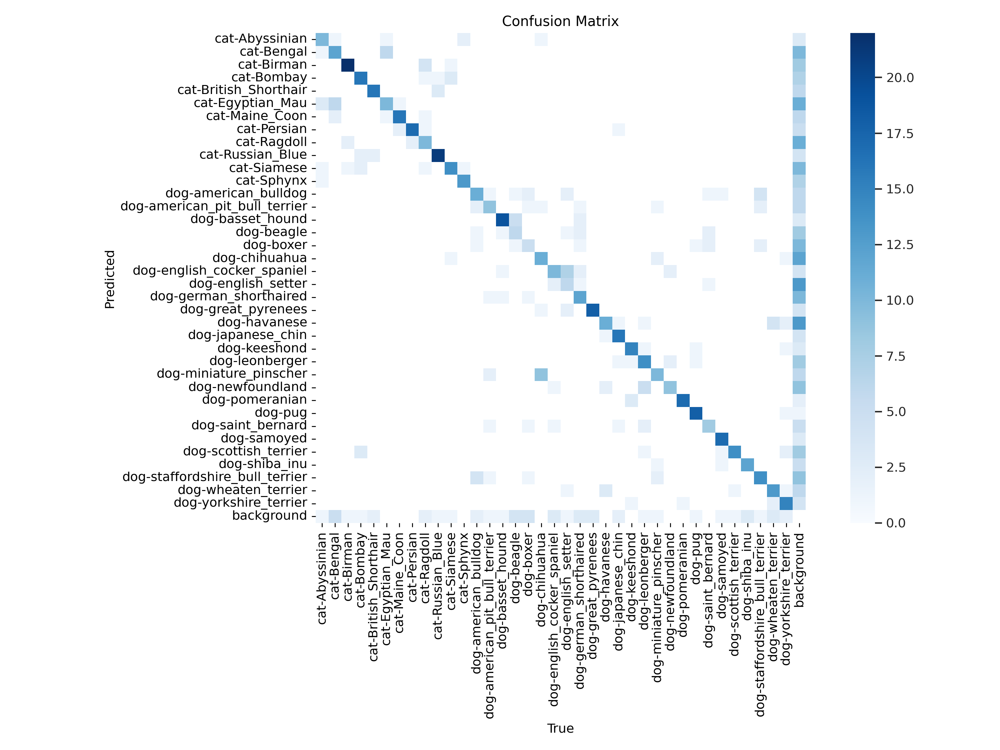

In [7]:
from PIL import Image
im = Image.open('/content/runs/detect/train/confusion_matrix.png')
im.show()
display(im)

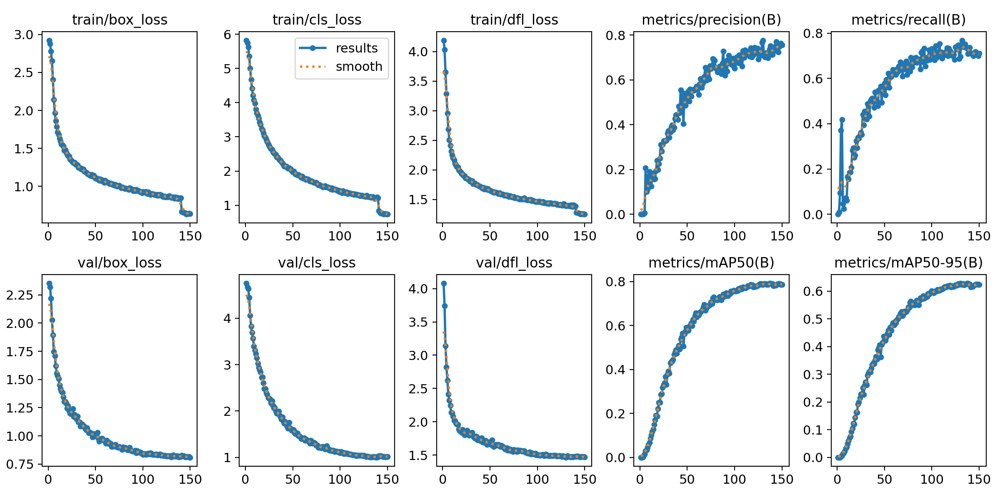

In [8]:
im = Image.open('/content/runs/detect/train/results.png')
im.show()
display(im)

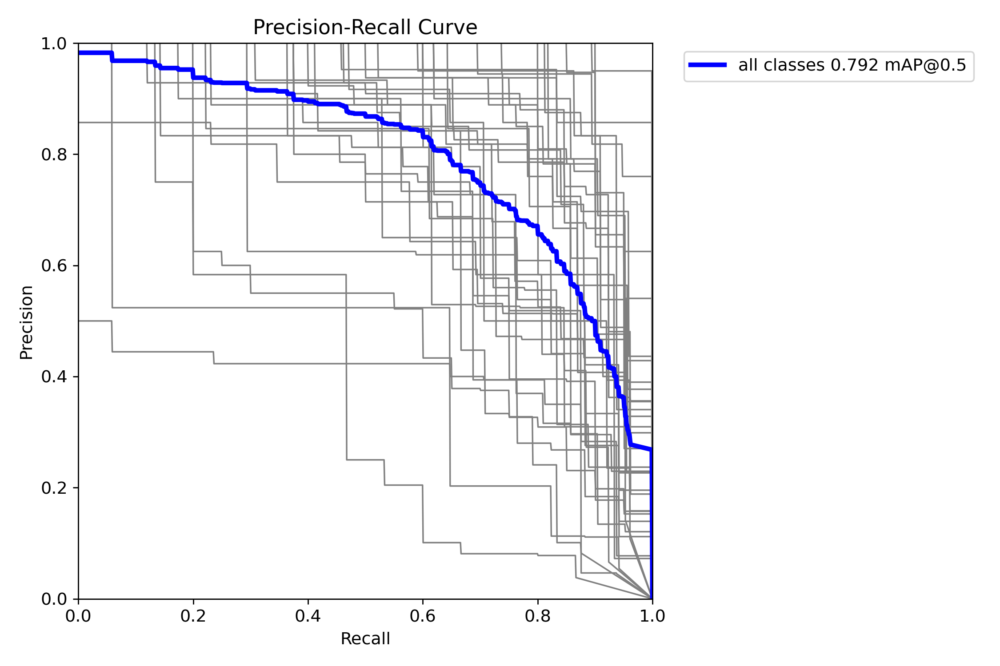

In [9]:
im = Image.open('/content/runs/detect/train/PR_curve.png')
im.show()
display(im)

#### Вывод  
Графики обучения выглядят адекватно, переобучения не произошло, возможно, можно было добавить большее количество эпох или поэкспериментировать с lr (но в данной библиотеке он подбирался автоматически, что очень удобно)  
По confusion matrix видно, что модель в основном научилась правильно детектировать животных, но некоторые породы между собой она все равно немного путала, возможно это связано со схожими чертами данных пород (например, для чихуа-хуа модель часто предсказывала пиншчер)  
В среднем качество модели лучше случайного предсказания, что видно по ROC_AUC кривой, но по ней же видно что для некоторых классов модель не смогла вообще правильно детектировать

Можно посмотреть на примере батча из трейна как происходить детекция изображений

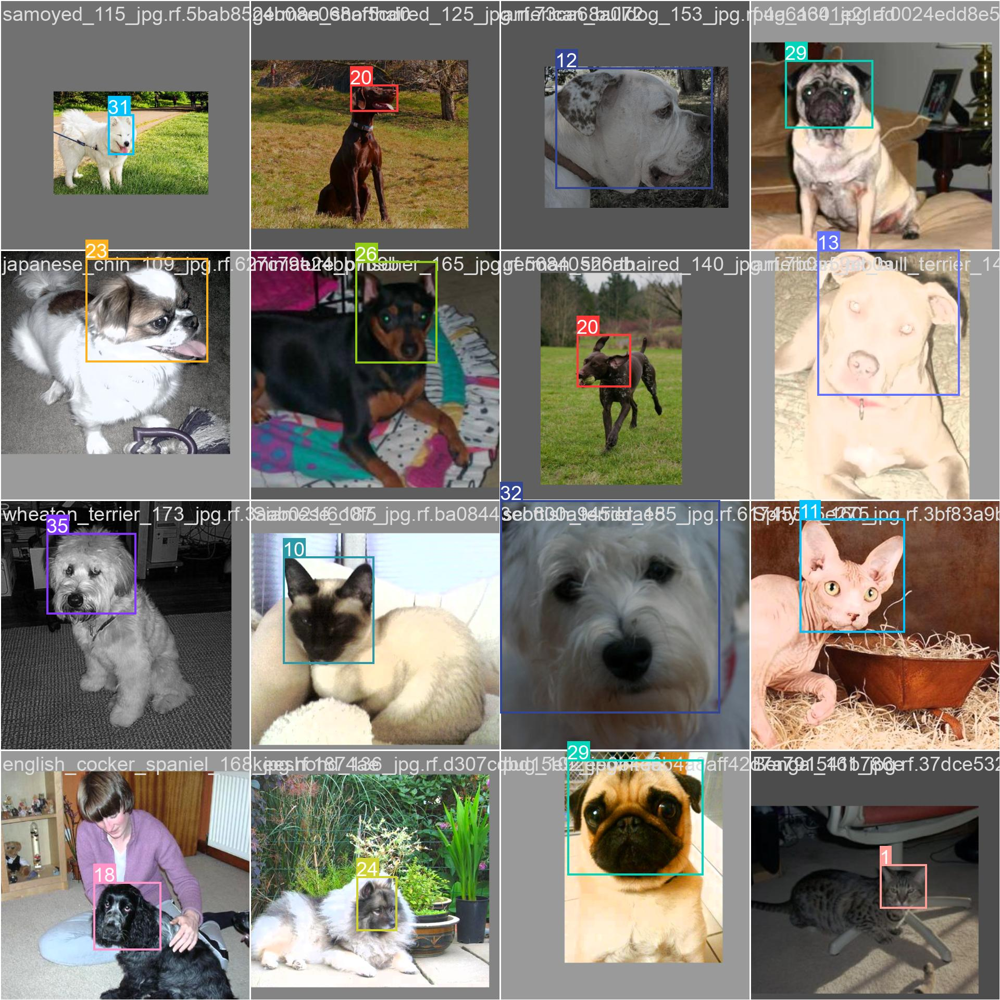

In [10]:
im = Image.open('/content/runs/detect/train/train_batch22540.jpg')
im.show()
display(im)

Чтобы использовать тестовый датасет, поменяем пути в data.yaml и напишем в val данные из test

In [11]:
# Customize validation settings
test_results = model_yolo.val()

Ultralytics YOLOv8.1.47 🚀 Python-3.10.12 torch-2.2.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLOv8n summary (fused): 168 layers, 3012863 parameters, 0 gradients, 8.1 GFLOPs


val: Scanning /content/Oxford-Pets-1/test/labels... 368 images, 0 backgrounds, 0 corrupt: 100%|██████████| 368/368 [00:00<00:00, 1430.00it/s]

val: New cache created: /content/Oxford-Pets-1/test/labels.cache



os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 23/23 [00:07<00:00,  3.15it/s]


                   all        368        368      0.687      0.761      0.789      0.628
        cat-Abyssinian        368          7       0.51      0.596      0.637      0.575
            cat-Bengal        368         11      0.636      0.478      0.477      0.345
            cat-Birman        368         15      0.804        0.8      0.931        0.8
            cat-Bombay        368          9          1      0.859       0.89      0.771
 cat-British_Shorthair        368         11       0.83      0.887      0.914      0.779
      cat-Egyptian_Mau        368          7       0.48      0.857       0.83      0.714
        cat-Maine_Coon        368         12      0.762      0.833      0.898      0.792
           cat-Persian        368         11      0.834      0.909      0.976      0.784
           cat-Ragdoll        368         10      0.666        0.8      0.774      0.596
      cat-Russian_Blue        368         11      0.817          1      0.965      0.825
           cat-Siames

### Метрики на тесте

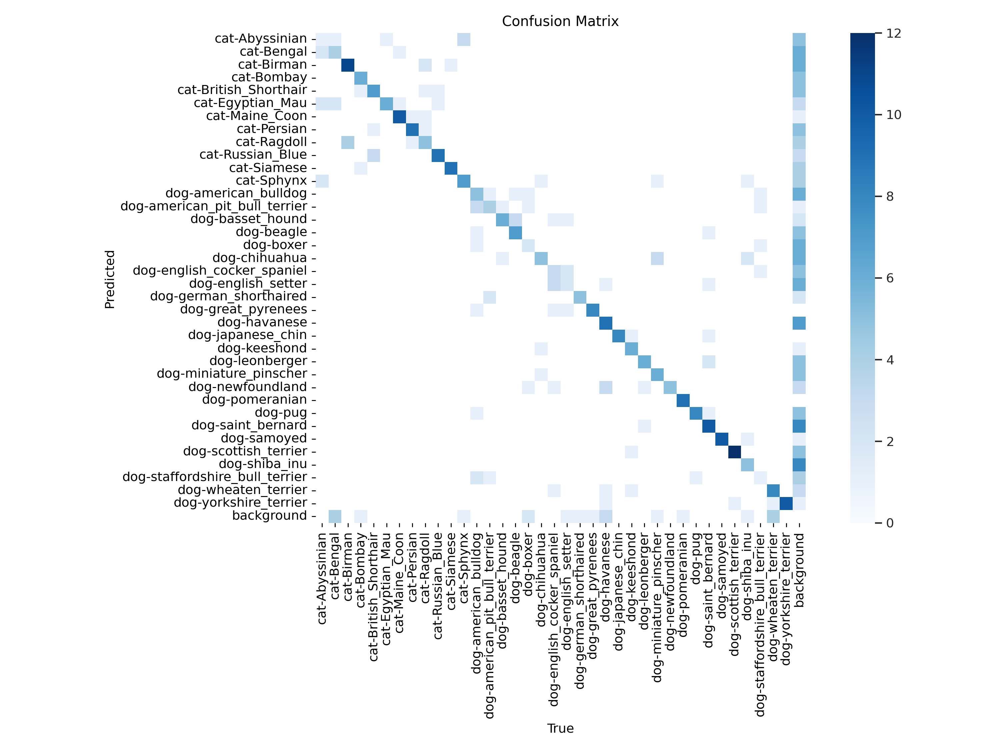

In [12]:
im = Image.open('/content/runs/detect/train2/confusion_matrix.png')
im.show()
display(im)

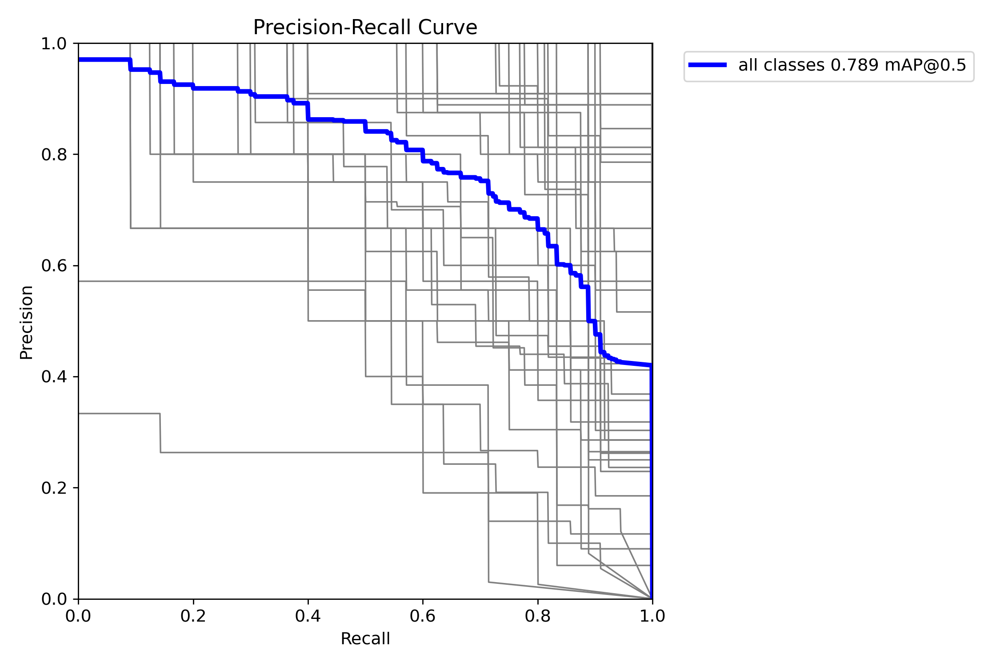

In [13]:
im = Image.open('/content/runs/detect/train2/PR_curve.png')
im.show()
display(im)

#### Вывод  
Качество на тесте хуже чем на трейне, но видно что модель в основном научилась детектировать животных  
Также можно заметить, что модель не путает кошек с собаками, а это хороший показатель правильного обучения

Предскажем 10 изображений

In [14]:
import os
import random

random_file = random.choice(os.listdir("/content/Oxford-Pets-1/test/images"))
file_name = os.path.join("/content/Oxford-Pets-1/test/images", random_file)

test_imgs = []
for i in range(0, 10):
  random_file = random.choice(os.listdir("/content/Oxford-Pets-1/test/images"))
  file_name = os.path.join("/content/Oxford-Pets-1/test/images", random_file)
  test_imgs.append(file_name)


results = model_yolo(test_imgs, save=True)



0: 640x640 1 dog-havanese, 9.0ms
1: 640x640 (no detections), 9.0ms
2: 640x640 1 dog-american_bulldog, 1 dog-basset_hound, 9.0ms
3: 640x640 1 dog-scottish_terrier, 9.0ms
4: 640x640 1 dog-pug, 9.0ms
5: 640x640 1 cat-British_Shorthair, 9.0ms
6: 640x640 1 dog-shiba_inu, 9.0ms
7: 640x640 1 dog-yorkshire_terrier, 9.0ms
8: 640x640 1 cat-Ragdoll, 9.0ms
9: 640x640 1 cat-Maine_Coon, 9.0ms
Speed: 7.4ms preprocess, 9.0ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)
Results saved to runs/detect/train3


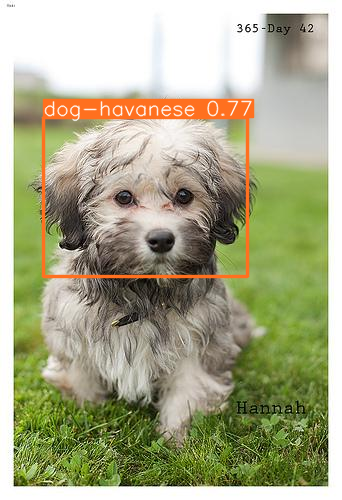

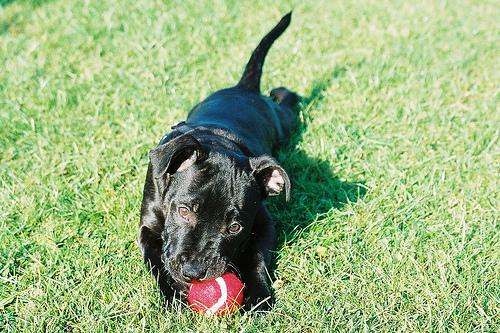

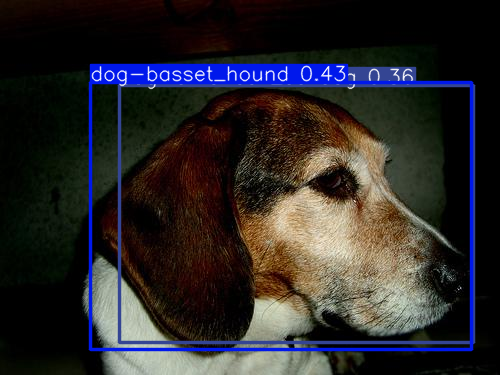

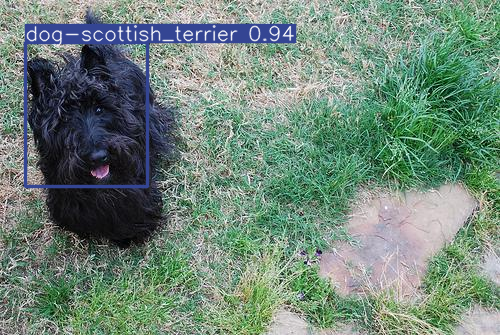

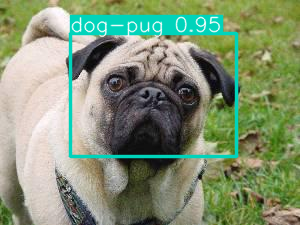

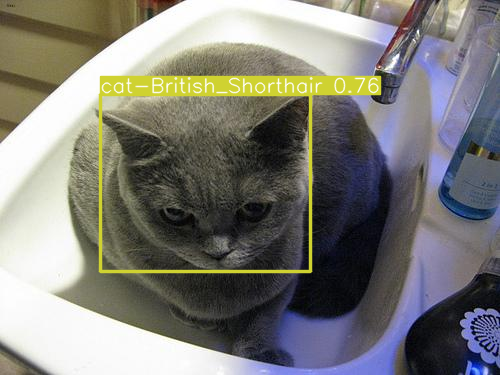

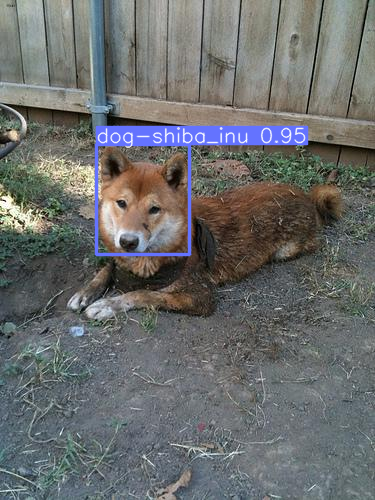

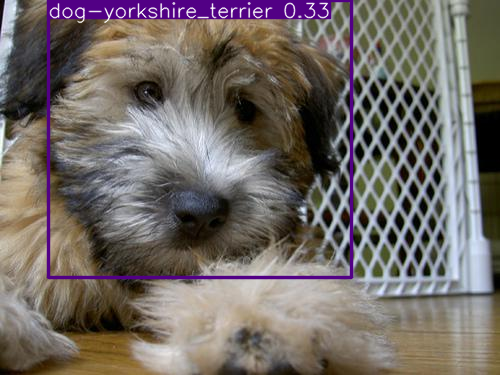

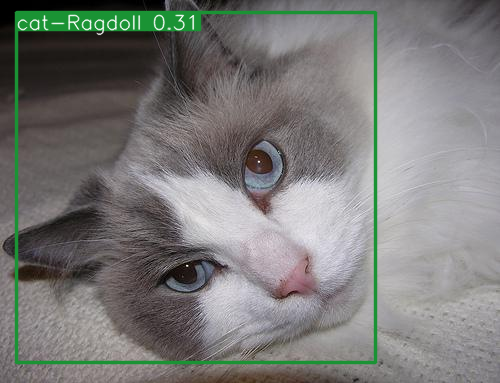

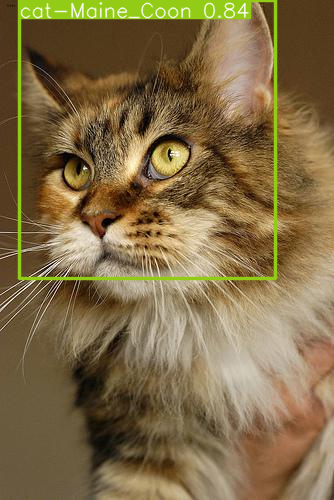

In [15]:
for i, result in enumerate(results):
  im_bgr = result.plot()  # BGR-order numpy array
  im_rgb = Image.fromarray(im_bgr[..., ::-1])  # RGB-order PIL image
  im_rgb.show()
  display(im_rgb)

Вывод: видно что если мордочка животного смотрит не прямо в камеру, то моделе сложно детектировать кто это и какой породы, возможно, нужно было добавить больше таких примеров в обучающи датасет, но главное, что на большинстве фотографий модель правильно смогла детектировать животное